# Classification


In [170]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.dummy import DummyClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
from sklearn import svm 
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.feature_selection import RFE

# 1. Without normalisation

# 1.1. Load data


In [2]:
train_df=pd.read_csv("C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal classification\\TRAIN.csv")
train_df

,ID,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,1.0,83.333333,720.000000,65.319726,720,60.514873,60.524027,76.315789,23.684211,0,...,0.411577,0.588423,42.918140,51.316902,1.540445,1.0,1,GroupA\01,7.0,3.0
1,1.0,84.151473,713.000000,60.588778,700,47.534893,47.931575,71.794872,15.384615,0,...,0.241666,0.758334,28.158470,49.880580,1.299283,1.0,1,GroupA\01,7.0,3.0
2,1.0,87.988827,681.904762,107.597975,680,155.535574,155.547812,65.853659,14.634146,0,...,0.498345,0.501655,77.704576,77.962147,1.347074,1.0,1,GroupA\01,7.0,3.0
3,1.0,92.847318,646.222222,108.305922,640,148.075813,148.078603,47.727273,9.090909,0,...,0.498938,0.501062,78.179529,78.345817,1.046787,1.0,1,NaN,NaN,NaN
4,1.0,94.903339,632.222222,118.441526,600,164.507924,164.507924,45.714286,5.714286,0,...,0.500000,0.500000,86.173559,86.173559,0.856187,1.0,1,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2062,9.0,72.072072,832.500000,81.509202,840,97.177654,97.186220,67.741935,16.129032,0,...,0.498658,0.501342,59.367460,59.526983,0.864997,1.0,1,GroupB\09,6.0,8.0
2063,9.0,69.093611,868.387097,80.766361,880,96.526335,96.609178,70.000000,13.333333,0,...,0.516939,0.483061,59.347086,57.369475,1.791759,1.0,1,GroupB\09,6.0,8.0
2064,9.0,70.454545,851.612903,73.401098,880,70.414645,70.427267,66.666667,16.666667,0,...,0.491474,0.508526,52.751859,53.659206,2.079442,1.0,1,GroupB\09,6.0,8.0
2065,9.0,69.444444,864.000000,74.188948,880,77.438173,77.548650,72.413793,34.482759,0,...,0.505367,0.494633,53.768467,53.194375,1.897120,1.0,1,NaN,NaN,8.0


In [3]:
del train_df['video']
del train_df['valence']
del train_df['ID']
train_df.dropna(axis=0, inplace=True, subset=['arousal'])
train_df

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,83.333333,720.000000,65.319726,720,60.514873,60.524027,76.315789,23.684211,0,320,...,51.440215,66.510192,0.411577,0.588423,42.918140,51.316902,1.540445,1.0,1,7.0
1,84.151473,713.000000,60.588778,700,47.534893,47.931575,71.794872,15.384615,0,280,...,34.435430,64.785779,0.241666,0.758334,28.158470,49.880580,1.299283,1.0,1,7.0
2,87.988827,681.904762,107.597975,680,155.535574,155.547812,65.853659,14.634146,0,720,...,77.045457,76.786670,0.498345,0.501655,77.704576,77.962147,1.347074,1.0,1,7.0
8,85.774059,699.512195,51.605975,720,40.938979,40.987803,67.500000,12.500000,0,200,...,48.336693,46.187744,0.526746,0.473254,37.471528,35.517962,1.167605,1.0,1,8.0
9,86.741890,691.707317,36.686040,680,35.199432,35.213634,62.500000,5.000000,0,160,...,32.909258,32.965503,0.495684,0.504316,26.369599,26.598209,1.037988,1.0,1,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,66.298343,905.000000,47.696960,920,43.528072,43.699856,61.290323,19.354839,0,200,...,46.101729,37.643010,0.587036,0.412964,36.460271,30.580464,0.897942,1.0,1,2.0
2059,65.217391,920.000000,39.349550,920,43.817805,43.817805,63.333333,13.333333,0,160,...,34.866796,31.424909,0.518431,0.481569,28.784308,27.742107,0.838329,1.0,1,2.0
2062,72.072072,832.500000,81.509202,840,97.177654,97.186220,67.741935,16.129032,0,440,...,66.400231,69.619849,0.498658,0.501342,59.367460,59.526983,0.864997,1.0,1,6.0
2063,69.093611,868.387097,80.766361,880,96.526335,96.609178,70.000000,13.333333,0,440,...,65.674339,66.977322,0.516939,0.483061,59.347086,57.369475,1.791759,1.0,1,6.0


In [4]:
train_df_cl=train_df.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
train_df_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,83.333333,720.000000,65.319726,720,60.514873,60.524027,76.315789,23.684211,0,320,...,51.440215,66.510192,0.411577,0.588423,42.918140,51.316902,1.540445,1.0,1,high
1,84.151473,713.000000,60.588778,700,47.534893,47.931575,71.794872,15.384615,0,280,...,34.435430,64.785779,0.241666,0.758334,28.158470,49.880580,1.299283,1.0,1,high
2,87.988827,681.904762,107.597975,680,155.535574,155.547812,65.853659,14.634146,0,720,...,77.045457,76.786670,0.498345,0.501655,77.704576,77.962147,1.347074,1.0,1,high
8,85.774059,699.512195,51.605975,720,40.938979,40.987803,67.500000,12.500000,0,200,...,48.336693,46.187744,0.526746,0.473254,37.471528,35.517962,1.167605,1.0,1,high
9,86.741890,691.707317,36.686040,680,35.199432,35.213634,62.500000,5.000000,0,160,...,32.909258,32.965503,0.495684,0.504316,26.369599,26.598209,1.037988,1.0,1,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,66.298343,905.000000,47.696960,920,43.528072,43.699856,61.290323,19.354839,0,200,...,46.101729,37.643010,0.587036,0.412964,36.460271,30.580464,0.897942,1.0,1,low
2059,65.217391,920.000000,39.349550,920,43.817805,43.817805,63.333333,13.333333,0,160,...,34.866796,31.424909,0.518431,0.481569,28.784308,27.742107,0.838329,1.0,1,low
2062,72.072072,832.500000,81.509202,840,97.177654,97.186220,67.741935,16.129032,0,440,...,66.400231,69.619849,0.498658,0.501342,59.367460,59.526983,0.864997,1.0,1,medium
2063,69.093611,868.387097,80.766361,880,96.526335,96.609178,70.000000,13.333333,0,440,...,65.674339,66.977322,0.516939,0.483061,59.347086,57.369475,1.791759,1.0,1,medium


In [5]:
validation_df=pd.read_csv('C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal classification\\VALIDATION.csv')
validation_df

,ID,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,12,116.417910,515.384615,68.232113,520,89.439280,89.442719,52.941176,9.803922,0,...,0.505366,0.494634,49.400621,48.873288,0.884815,1.000000,1,NaN,NaN,NaN
1,12,104.529617,574.000000,190.063147,520,211.366675,211.369163,56.410256,17.948718,0,...,0.305641,0.694359,107.581059,162.151942,0.957113,0.773270,1,NaN,NaN,NaN
2,12,98.056537,611.891892,244.969252,520,294.081537,294.089933,55.555556,25.000000,0,...,0.357307,0.642693,150.207499,201.452486,0.310891,0.462540,1,NaN,NaN,NaN
3,12,101.739130,589.743590,235.115762,520,235.697821,236.732138,44.736842,21.052632,0,...,0.231213,0.768787,107.624632,196.249717,0.152151,0.518304,1,GroupB\07,7.0,7.0
4,12,114.245416,525.185185,91.423733,520,115.941823,116.295006,50.943396,15.094340,0,...,0.365836,0.634164,49.980909,65.805438,0.764099,1.000000,1,GroupB\07,7.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
484,6,74.175824,808.888889,182.601232,780,248.202682,248.331576,88.571429,48.571429,40,...,0.470135,0.529865,119.867073,127.253941,1.431100,0.815500,1,GroupA\04,5.0,6.0
485,6,76.056338,788.888889,116.851705,760,138.818337,138.893587,94.285714,45.714286,40,...,0.533749,0.466251,86.830823,81.154929,1.466337,1.000000,1,GroupA\04,5.0,6.0
486,6,76.704545,782.222222,139.982362,780,173.300259,173.304027,85.714286,51.428571,0,...,0.525531,0.474469,103.328821,98.180738,1.431100,1.000000,1,NaN,NaN,NaN
487,6,80.168776,748.421053,141.542746,720,199.675412,199.675412,83.783784,48.648649,-40,...,0.473101,0.526899,99.227926,104.717862,1.431100,1.000000,1,GroupA\05,3.0,4.0


In [6]:
del validation_df['video']
del validation_df['valence']
del validation_df['ID']
validation_df.dropna(axis=0, inplace=True, subset=['arousal'])
validation_df

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
3,101.739130,589.743590,235.115762,520,235.697821,236.732138,44.736842,21.052632,0,880,...,105.976354,245.325620,0.231213,0.768787,107.624632,196.249717,0.152151,0.518304,1,7.0
4,114.245416,525.185185,91.423733,520,115.941823,116.295006,50.943396,15.094340,0,520,...,50.038734,65.274125,0.365836,0.634164,49.980909,65.805438,0.764099,1.000000,1,7.0
5,117.318436,511.428571,33.563829,520,31.416162,31.449816,45.454545,5.454545,0,160,...,30.011282,29.497412,0.493695,0.506305,23.694929,23.995612,0.677061,1.000000,1,7.0
8,106.656581,562.553192,160.722678,520,200.107721,200.260700,84.782609,34.782609,0,600,...,127.711326,119.506881,0.514109,0.485891,114.598731,111.409418,1.280934,0.939317,1,9.0
9,106.174699,565.106383,121.722956,520,152.481676,152.543650,71.739130,28.260870,0,560,...,81.464411,109.387729,0.435067,0.564933,81.448025,92.811361,1.098612,1.000000,1,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,82.191781,730.000000,165.563013,720,266.694965,266.704759,85.714286,48.571429,0,1080,...,119.023639,83.805067,0.505616,0.494384,120.883105,119.532904,1.431100,0.911924,1,5.0
484,74.175824,808.888889,182.601232,780,248.202682,248.331576,88.571429,48.571429,40,960,...,128.913085,112.976110,0.470135,0.529865,119.867073,127.253941,1.431100,0.815500,1,5.0
485,76.056338,788.888889,116.851705,760,138.818337,138.893587,94.285714,45.714286,40,480,...,101.386309,89.681844,0.533749,0.466251,86.830823,81.154929,1.466337,1.000000,1,5.0
487,80.168776,748.421053,141.542746,720,199.675412,199.675412,83.783784,48.648649,-40,640,...,91.670463,112.834664,0.473101,0.526899,99.227926,104.717862,1.431100,1.000000,1,3.0


In [7]:
validation_df_cl=train_df.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
validation_df_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,83.333333,720.000000,65.319726,720,60.514873,60.524027,76.315789,23.684211,0,320,...,51.440215,66.510192,0.411577,0.588423,42.918140,51.316902,1.540445,1.0,1,high
1,84.151473,713.000000,60.588778,700,47.534893,47.931575,71.794872,15.384615,0,280,...,34.435430,64.785779,0.241666,0.758334,28.158470,49.880580,1.299283,1.0,1,high
2,87.988827,681.904762,107.597975,680,155.535574,155.547812,65.853659,14.634146,0,720,...,77.045457,76.786670,0.498345,0.501655,77.704576,77.962147,1.347074,1.0,1,high
8,85.774059,699.512195,51.605975,720,40.938979,40.987803,67.500000,12.500000,0,200,...,48.336693,46.187744,0.526746,0.473254,37.471528,35.517962,1.167605,1.0,1,high
9,86.741890,691.707317,36.686040,680,35.199432,35.213634,62.500000,5.000000,0,160,...,32.909258,32.965503,0.495684,0.504316,26.369599,26.598209,1.037988,1.0,1,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,66.298343,905.000000,47.696960,920,43.528072,43.699856,61.290323,19.354839,0,200,...,46.101729,37.643010,0.587036,0.412964,36.460271,30.580464,0.897942,1.0,1,low
2059,65.217391,920.000000,39.349550,920,43.817805,43.817805,63.333333,13.333333,0,160,...,34.866796,31.424909,0.518431,0.481569,28.784308,27.742107,0.838329,1.0,1,low
2062,72.072072,832.500000,81.509202,840,97.177654,97.186220,67.741935,16.129032,0,440,...,66.400231,69.619849,0.498658,0.501342,59.367460,59.526983,0.864997,1.0,1,medium
2063,69.093611,868.387097,80.766361,880,96.526335,96.609178,70.000000,13.333333,0,440,...,65.674339,66.977322,0.516939,0.483061,59.347086,57.369475,1.791759,1.0,1,medium


In [8]:
test_df=pd.read_csv("C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal classification\\TEST.csv")
test_df

,ID,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,13,86.558761,693.170732,51.817646,680,53.383050,53.385391,72.500000,22.500000,0,...,0.514255,0.485745,38.032554,36.963242,1.634131,1.000000,1,GroupD\16,5.0,2.0
1,13,84.985836,706.000000,67.852782,720,54.638854,54.725422,74.358974,15.384615,0,...,0.542650,0.457350,50.611404,46.463573,1.871802,1.000000,1,NaN,NaN,NaN
2,13,84.269663,712.000000,68.234888,720,53.589130,53.589130,74.358974,12.820513,0,...,0.520441,0.479559,50.183097,48.171809,1.268511,1.000000,1,NaN,NaN,NaN
3,13,84.745763,708.000000,61.449166,720,41.459247,41.509962,64.102564,10.256410,0,...,0.511279,0.488721,44.123273,43.138893,1.299283,1.000000,1,GroupD\17,7.0,2.0
4,13,86.741890,691.707317,45.258199,680,49.759421,49.799598,62.500000,22.500000,0,...,0.493288,0.506712,32.252211,32.688114,1.386294,1.000000,1,GroupD\17,7.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,8,74.013158,810.666667,97.943294,800,146.817204,146.875504,82.758621,51.724138,0,...,0.522517,0.477483,72.500476,69.305749,1.431100,1.000000,1,GroupD\20,2.0,1.0
480,8,73.991031,810.909091,58.484063,840,51.462972,51.478151,71.875000,31.250000,0,...,0.520288,0.479712,42.964800,41.255422,1.791759,1.000000,1,GroupD\20,2.0,1.0
481,8,71.629213,837.647059,52.190760,840,53.470897,53.484634,72.727273,30.303030,0,...,0.549933,0.450067,39.738947,35.950063,1.386294,1.000000,1,GroupD\20,2.0,1.0
482,8,70.454545,851.612903,167.622786,840,152.659389,153.362316,76.666667,33.333333,0,...,0.410649,0.589351,103.661880,124.185469,1.504077,0.900267,1,GroupD\20,2.0,1.0


In [9]:
del test_df['video']
del test_df['valence']
del test_df['ID']
test_df.dropna(axis=0, inplace=True, subset=['arousal'])
test_df

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,86.558761,693.170732,51.817646,680,53.383050,53.385391,72.500000,22.500000,0,200,...,47.292072,43.902555,0.514255,0.485745,38.032554,36.963242,1.634131,1.000000,1,5.0
3,84.745763,708.000000,61.449166,720,41.459247,41.509962,64.102564,10.256410,0,240,...,58.210508,57.818515,0.511279,0.488721,44.123273,43.138893,1.299283,1.000000,1,7.0
4,86.741890,691.707317,45.258199,680,49.759421,49.799598,62.500000,22.500000,0,200,...,38.006747,38.744396,0.493288,0.506712,32.252211,32.688114,1.386294,1.000000,1,7.0
5,89.235127,672.380952,51.815126,680,63.060927,63.091107,60.975610,29.268293,0,240,...,40.278477,42.918929,0.472778,0.527222,36.071843,38.092220,1.763589,1.000000,1,7.0
8,81.818182,733.333333,51.507198,720,49.830738,49.841855,63.157895,26.315789,0,280,...,43.727463,48.794865,0.467610,0.532390,36.083119,38.501446,1.421386,1.000000,1,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,74.013158,810.666667,97.943294,800,146.817204,146.875504,82.758621,51.724138,0,560,...,76.707670,55.350851,0.522517,0.477483,72.500476,69.305749,1.431100,1.000000,1,2.0
480,73.991031,810.909091,58.484063,840,51.462972,51.478151,71.875000,31.250000,0,240,...,55.430977,51.532830,0.520288,0.479712,42.964800,41.255422,1.791759,1.000000,1,2.0
481,71.629213,837.647059,52.190760,840,53.470897,53.484634,72.727273,30.303030,0,240,...,50.083608,41.950138,0.549933,0.450067,39.738947,35.950063,1.386294,1.000000,1,2.0
482,70.454545,851.612903,167.622786,840,152.659389,153.362316,76.666667,33.333333,0,880,...,104.263518,171.170189,0.410649,0.589351,103.661880,124.185469,1.504077,0.900267,1,2.0


In [10]:
test_df_cl=test_df.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
test_df_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,86.558761,693.170732,51.817646,680,53.383050,53.385391,72.500000,22.500000,0,200,...,47.292072,43.902555,0.514255,0.485745,38.032554,36.963242,1.634131,1.000000,1,medium
3,84.745763,708.000000,61.449166,720,41.459247,41.509962,64.102564,10.256410,0,240,...,58.210508,57.818515,0.511279,0.488721,44.123273,43.138893,1.299283,1.000000,1,high
4,86.741890,691.707317,45.258199,680,49.759421,49.799598,62.500000,22.500000,0,200,...,38.006747,38.744396,0.493288,0.506712,32.252211,32.688114,1.386294,1.000000,1,high
5,89.235127,672.380952,51.815126,680,63.060927,63.091107,60.975610,29.268293,0,240,...,40.278477,42.918929,0.472778,0.527222,36.071843,38.092220,1.763589,1.000000,1,high
8,81.818182,733.333333,51.507198,720,49.830738,49.841855,63.157895,26.315789,0,280,...,43.727463,48.794865,0.467610,0.532390,36.083119,38.501446,1.421386,1.000000,1,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,74.013158,810.666667,97.943294,800,146.817204,146.875504,82.758621,51.724138,0,560,...,76.707670,55.350851,0.522517,0.477483,72.500476,69.305749,1.431100,1.000000,1,low
480,73.991031,810.909091,58.484063,840,51.462972,51.478151,71.875000,31.250000,0,240,...,55.430977,51.532830,0.520288,0.479712,42.964800,41.255422,1.791759,1.000000,1,low
481,71.629213,837.647059,52.190760,840,53.470897,53.484634,72.727273,30.303030,0,240,...,50.083608,41.950138,0.549933,0.450067,39.738947,35.950063,1.386294,1.000000,1,low
482,70.454545,851.612903,167.622786,840,152.659389,153.362316,76.666667,33.333333,0,880,...,104.263518,171.170189,0.410649,0.589351,103.661880,124.185469,1.504077,0.900267,1,low


#  1.2. Data visualization 


In [11]:
def get_percentage_cnt(df, col):   
    t1 = pd.DataFrame(df.groupby(col)[col].count().rename('cnt%'))
    t1.reset_index(inplace=True)
    t1['cnt%'] = round((t1['cnt%'] * 100) / t1['cnt%'].sum(),2)
    return t1

def myplot(x, y, df):
    ax = sns.barplot(x=x, y=y, data=df)
    for p in ax.patches:
        ax.annotate('{0:.1f}%'.format(p.get_height()), (p.get_x()+0.1, p.get_height()))

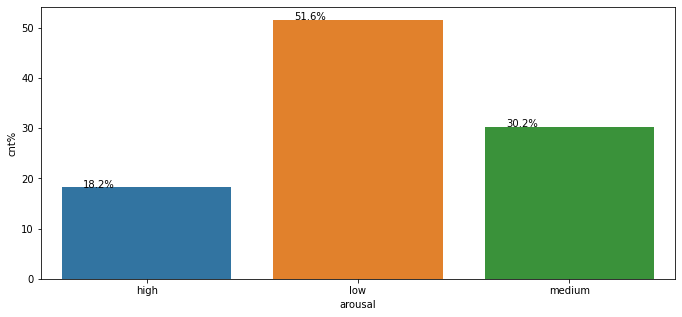

In [12]:
plt.figure(figsize=(25,5))

dual_categories = ['arousal']
plt_cnt = 1;
for feature in dual_categories:
    plt.subplot(1,2,plt_cnt)
    tempdf = get_percentage_cnt(validation_df_cl, feature)
    myplot(feature, 'cnt%', tempdf)
    plt_cnt += 1

plt.show()

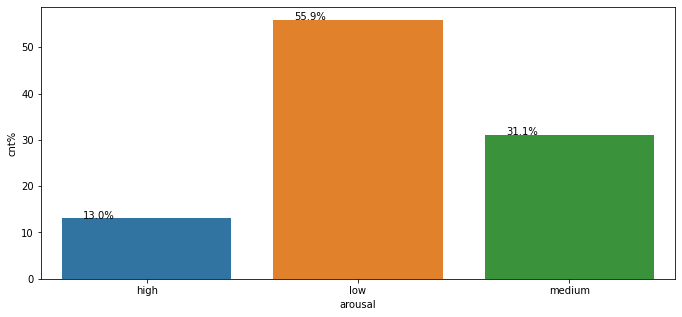

In [13]:
plt.figure(figsize=(25,5))

dual_categories = ['arousal']

plt_cnt = 1;
for feature in dual_categories:
    plt.subplot(1,2,plt_cnt)
    tempdf = get_percentage_cnt(test_df_cl, feature)
    myplot(feature, 'cnt%', tempdf)
    plt_cnt += 1

plt.show()

In [14]:
train_x=train_df_cl.drop(['arousal'], axis=1)
train_x

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality
0,83.333333,720.000000,65.319726,720,60.514873,60.524027,76.315789,23.684211,0,320,...,0.625713,51.440215,66.510192,0.411577,0.588423,42.918140,51.316902,1.540445,1.0,1
1,84.151473,713.000000,60.588778,700,47.534893,47.931575,71.794872,15.384615,0,280,...,0.779714,34.435430,64.785779,0.241666,0.758334,28.158470,49.880580,1.299283,1.0,1
2,87.988827,681.904762,107.597975,680,155.535574,155.547812,65.853659,14.634146,0,720,...,0.498318,77.045457,76.786670,0.498345,0.501655,77.704576,77.962147,1.347074,1.0,1
8,85.774059,699.512195,51.605975,720,40.938979,40.987803,67.500000,12.500000,0,200,...,0.477277,48.336693,46.187744,0.526746,0.473254,37.471528,35.517962,1.167605,1.0,1
9,86.741890,691.707317,36.686040,680,35.199432,35.213634,62.500000,5.000000,0,160,...,0.500854,32.909258,32.965503,0.495684,0.504316,26.369599,26.598209,1.037988,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,66.298343,905.000000,47.696960,920,43.528072,43.699856,61.290323,19.354839,0,200,...,0.400014,46.101729,37.643010,0.587036,0.412964,36.460271,30.580464,0.897942,1.0,1
2059,65.217391,920.000000,39.349550,920,43.817805,43.817805,63.333333,13.333333,0,160,...,0.448219,34.866796,31.424909,0.518431,0.481569,28.784308,27.742107,0.838329,1.0,1
2062,72.072072,832.500000,81.509202,840,97.177654,97.186220,67.741935,16.129032,0,440,...,0.523657,66.400231,69.619849,0.498658,0.501342,59.367460,59.526983,0.864997,1.0,1
2063,69.093611,868.387097,80.766361,880,96.526335,96.609178,70.000000,13.333333,0,440,...,0.509822,65.674339,66.977322,0.516939,0.483061,59.347086,57.369475,1.791759,1.0,1


In [15]:
validation_x=validation_df_cl.drop(['arousal'], axis=1)
validation_x

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality
0,83.333333,720.000000,65.319726,720,60.514873,60.524027,76.315789,23.684211,0,320,...,0.625713,51.440215,66.510192,0.411577,0.588423,42.918140,51.316902,1.540445,1.0,1
1,84.151473,713.000000,60.588778,700,47.534893,47.931575,71.794872,15.384615,0,280,...,0.779714,34.435430,64.785779,0.241666,0.758334,28.158470,49.880580,1.299283,1.0,1
2,87.988827,681.904762,107.597975,680,155.535574,155.547812,65.853659,14.634146,0,720,...,0.498318,77.045457,76.786670,0.498345,0.501655,77.704576,77.962147,1.347074,1.0,1
8,85.774059,699.512195,51.605975,720,40.938979,40.987803,67.500000,12.500000,0,200,...,0.477277,48.336693,46.187744,0.526746,0.473254,37.471528,35.517962,1.167605,1.0,1
9,86.741890,691.707317,36.686040,680,35.199432,35.213634,62.500000,5.000000,0,160,...,0.500854,32.909258,32.965503,0.495684,0.504316,26.369599,26.598209,1.037988,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,66.298343,905.000000,47.696960,920,43.528072,43.699856,61.290323,19.354839,0,200,...,0.400014,46.101729,37.643010,0.587036,0.412964,36.460271,30.580464,0.897942,1.0,1
2059,65.217391,920.000000,39.349550,920,43.817805,43.817805,63.333333,13.333333,0,160,...,0.448219,34.866796,31.424909,0.518431,0.481569,28.784308,27.742107,0.838329,1.0,1
2062,72.072072,832.500000,81.509202,840,97.177654,97.186220,67.741935,16.129032,0,440,...,0.523657,66.400231,69.619849,0.498658,0.501342,59.367460,59.526983,0.864997,1.0,1
2063,69.093611,868.387097,80.766361,880,96.526335,96.609178,70.000000,13.333333,0,440,...,0.509822,65.674339,66.977322,0.516939,0.483061,59.347086,57.369475,1.791759,1.0,1


In [16]:
test_x=test_df_cl.drop(['arousal'], axis=1)
test_x

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality
0,86.558761,693.170732,51.817646,680,53.383050,53.385391,72.500000,22.500000,0,200,...,0.462883,47.292072,43.902555,0.514255,0.485745,38.032554,36.963242,1.634131,1.000000,1
3,84.745763,708.000000,61.449166,720,41.459247,41.509962,64.102564,10.256410,0,240,...,0.496622,58.210508,57.818515,0.511279,0.488721,44.123273,43.138893,1.299283,1.000000,1
4,86.741890,691.707317,45.258199,680,49.759421,49.799598,62.500000,22.500000,0,200,...,0.509610,38.006747,38.744396,0.493288,0.506712,32.252211,32.688114,1.386294,1.000000,1
5,89.235127,672.380952,51.815126,680,63.060927,63.091107,60.975610,29.268293,0,240,...,0.531705,40.278477,42.918929,0.472778,0.527222,36.071843,38.092220,1.763589,1.000000,1
8,81.818182,733.333333,51.507198,720,49.830738,49.841855,63.157895,26.315789,0,280,...,0.554606,43.727463,48.794865,0.467610,0.532390,36.083119,38.501446,1.421386,1.000000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,74.013158,810.666667,97.943294,800,146.817204,146.875504,82.758621,51.724138,0,560,...,0.342400,76.707670,55.350851,0.522517,0.477483,72.500476,69.305749,1.431100,1.000000,1
480,73.991031,810.909091,58.484063,840,51.462972,51.478151,71.875000,31.250000,0,240,...,0.463605,55.430977,51.532830,0.520288,0.479712,42.964800,41.255422,1.791759,1.000000,1
481,71.629213,837.647059,52.190760,840,53.470897,53.484634,72.727273,30.303030,0,240,...,0.412310,50.083608,41.950138,0.549933,0.450067,39.738947,35.950063,1.386294,1.000000,1
482,70.454545,851.612903,167.622786,840,152.659389,153.362316,76.666667,33.333333,0,880,...,0.729379,104.263518,171.170189,0.410649,0.589351,103.661880,124.185469,1.504077,0.900267,1


In [17]:
train_y=train_df_cl["arousal"]
train_y

0         high
1         high
2         high
8         high
9         high
         ...  
2058       low
2059       low
2062    medium
2063    medium
2064    medium
Name: arousal, Length: 1509, dtype: object

In [18]:
validation_y=validation_df_cl["arousal"]
validation_y

0         high
1         high
2         high
8         high
9         high
         ...  
2058       low
2059       low
2062    medium
2063    medium
2064    medium
Name: arousal, Length: 1509, dtype: object

In [19]:
test_y=test_df_cl["arousal"]
test_y

0      medium
3        high
4        high
5        high
8         low
        ...  
479       low
480       low
481       low
482       low
483       low
Name: arousal, Length: 322, dtype: object

# 1.3. Standardisation

In [20]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
print(scaler.fit(train_x))
print(scaler.transform(train_x))

StandardScaler()
[[ 0.59170417 -0.65291379 -0.63462537 ...  0.28763243  0.44956845
   0.22546764]
 [ 0.67529581 -0.7217529  -0.69280724 ... -0.22877571  0.44956845
   0.22546764]
 [ 1.06736929 -1.02754844 -0.11468152 ... -0.12644001  0.44956845
   0.22546764]
 ...
 [-0.5588912   0.45342918 -0.43552492 ... -1.15872543  0.44956845
   0.22546764]
 [-0.86320914  0.80634862 -0.44466049 ...  0.82578017  0.44956845
   0.22546764]
 [-0.72415853  0.64138852 -0.53523953 ...  1.44180312  0.44956845
   0.22546764]]


In [21]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
print(scaler.fit(validation_x))
print(scaler.transform(validation_x))

StandardScaler()
[[ 0.59170417 -0.65291379 -0.63462537 ...  0.28763243  0.44956845
   0.22546764]
 [ 0.67529581 -0.7217529  -0.69280724 ... -0.22877571  0.44956845
   0.22546764]
 [ 1.06736929 -1.02754844 -0.11468152 ... -0.12644001  0.44956845
   0.22546764]
 ...
 [-0.5588912   0.45342918 -0.43552492 ... -1.15872543  0.44956845
   0.22546764]
 [-0.86320914  0.80634862 -0.44466049 ...  0.82578017  0.44956845
   0.22546764]
 [-0.72415853  0.64138852 -0.53523953 ...  1.44180312  0.44956845
   0.22546764]]


In [22]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
print(scaler.fit(test_x))
print(scaler.transform(test_x))

StandardScaler()
[[ 1.65052655 -1.39388133 -1.13656318 ...  0.22090585  0.68572007
   0.05581456]
 [ 1.42559927 -1.2425556  -1.02892192 ... -0.50332862  0.68572007
   0.05581456]
 [ 1.67324615 -1.40881479 -1.20987114 ... -0.3151336   0.68572007
   0.05581456]
 ...
 [-0.20168795  0.08043186 -1.13239328 ... -0.3151336   0.68572007
   0.05581456]
 [-0.34742157  0.22294676  0.15766769 ... -0.06038324  0.36387188
   0.05581456]
 [-0.75563649  0.64868419  1.09351773 ... -1.69069987 -1.16544976
   0.05581456]]


# 1.4.Corealation matrix

In [23]:
sns.set(font_scale=6.5)
correlation=train_df.corr()
plt.figure(figsize=(250,130))
sns.heatmap(correlation, annot=True, fmt='.3f')
plt.show()

<AxesSubplot:xlabel='AI', ylabel='GI'>

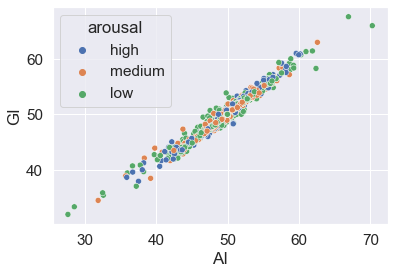

In [24]:

sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['AI'], y=train_df_cl['GI'], hue=train_df_cl['arousal'])


<AxesSubplot:xlabel='mean_hr', ylabel='ibi'>

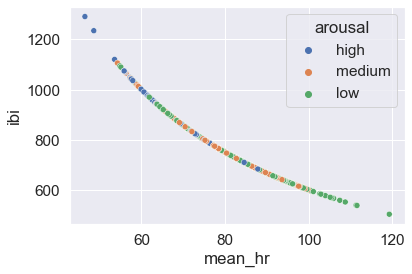

In [25]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['mean_hr'], y=train_df_cl['ibi'], hue=train_df_cl['arousal'])

<AxesSubplot:xlabel='hti', ylabel='samp_ent'>

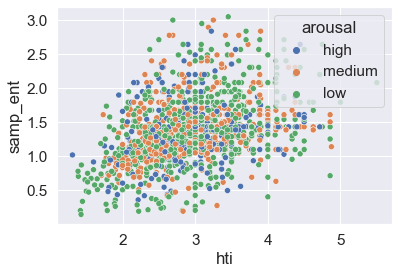

In [26]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['hti'], y=train_df_cl['samp_ent'], hue=train_df_cl['arousal'])

<AxesSubplot:xlabel='mean_hr', ylabel='sqi_sdnn'>

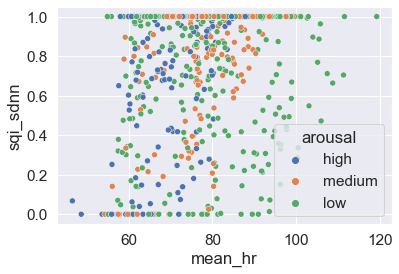

In [27]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['mean_hr'], y=train_df_cl['sqi_sdnn'], hue=train_df_cl['arousal'])

<AxesSubplot:xlabel='sdnn', ylabel='SDNNa'>

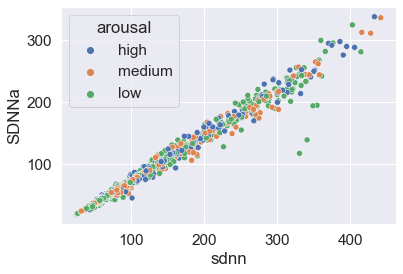

In [28]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['sdnn'], y=train_df_cl['SDNNa'], hue=train_df_cl['arousal'])

<AxesSubplot:xlabel='pnn20', ylabel='pnn50'>

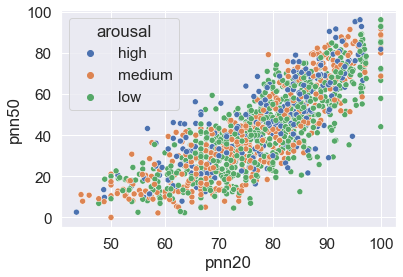

In [29]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['pnn20'], y=train_df_cl['pnn50'], hue=train_df_cl['arousal'])

<AxesSubplot:xlabel='cvi', ylabel='sdnn'>

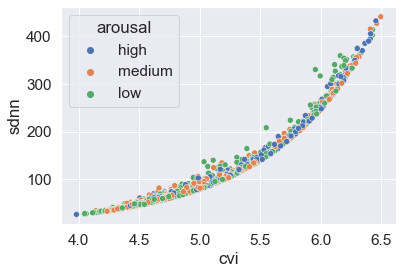

In [30]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['cvi'], y=train_df_cl['sdnn'], hue=train_df_cl['arousal'])

<AxesSubplot:xlabel='sdnn', ylabel='median_ibi'>

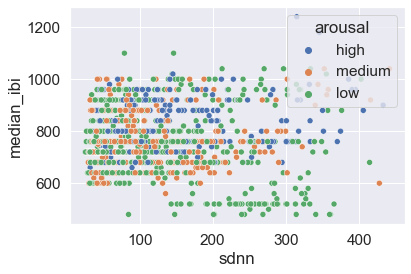

In [31]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['sdnn'], y=train_df_cl['median_ibi'], hue=train_df_cl['arousal'])

<AxesSubplot:xlabel='sd1', ylabel='SD1d'>

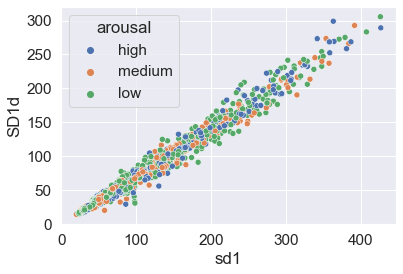

In [32]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_df_cl['sd1'], y=train_df_cl['SD1d'], hue=train_df_cl['arousal'])

(array([0, 1, 2]),
 [Text(0, 0, 'high'), Text(1, 0, 'medium'), Text(2, 0, 'low')])

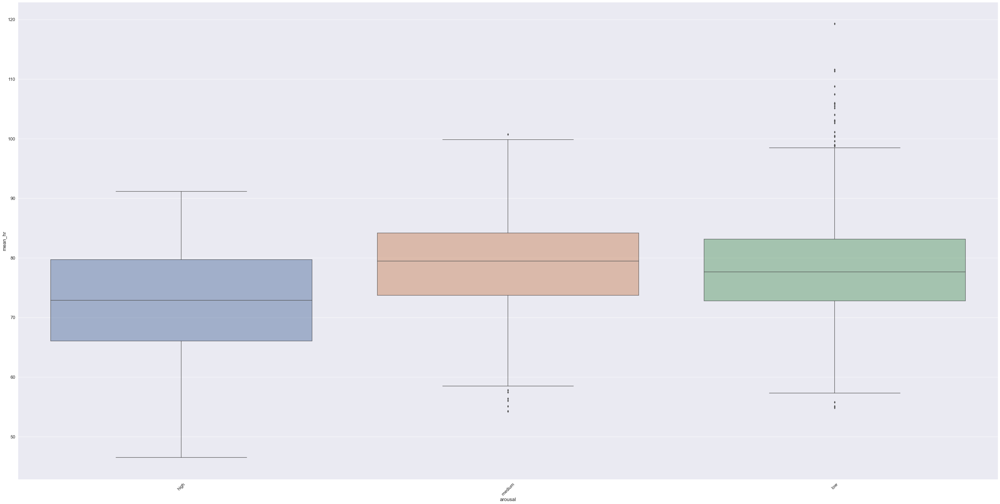

In [33]:
plt.figure(figsize = (60, 30))
ax = sns.boxplot(x='arousal', y='mean_hr', data=train_df_cl)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

array([[<AxesSubplot:title={'center':'mean_hr'}>,
        <AxesSubplot:title={'center':'ibi'}>,
        <AxesSubplot:title={'center':'sdnn'}>,
        <AxesSubplot:title={'center':'median_ibi'}>,
        <AxesSubplot:title={'center':'sdsd'}>,
        <AxesSubplot:title={'center':'rmssd'}>],
       [<AxesSubplot:title={'center':'pnn20'}>,
        <AxesSubplot:title={'center':'pnn50'}>,
        <AxesSubplot:title={'center':'median_diff'}>,
        <AxesSubplot:title={'center':'rr_range'}>,
        <AxesSubplot:title={'center':'rr_iqrange'}>,
        <AxesSubplot:title={'center':'cv_rmssd'}>],
       [<AxesSubplot:title={'center':'cv_sdnn'}>,
        <AxesSubplot:title={'center':'tinn'}>,
        <AxesSubplot:title={'center':'hti'}>,
        <AxesSubplot:title={'center':'sd1'}>,
        <AxesSubplot:title={'center':'sd2'}>,
        <AxesSubplot:title={'center':'sd1/sd2'}>],
       [<AxesSubplot:title={'center':'area_ell'}>,
        <AxesSubplot:title={'center':'csi'}>,
        <AxesSubplo

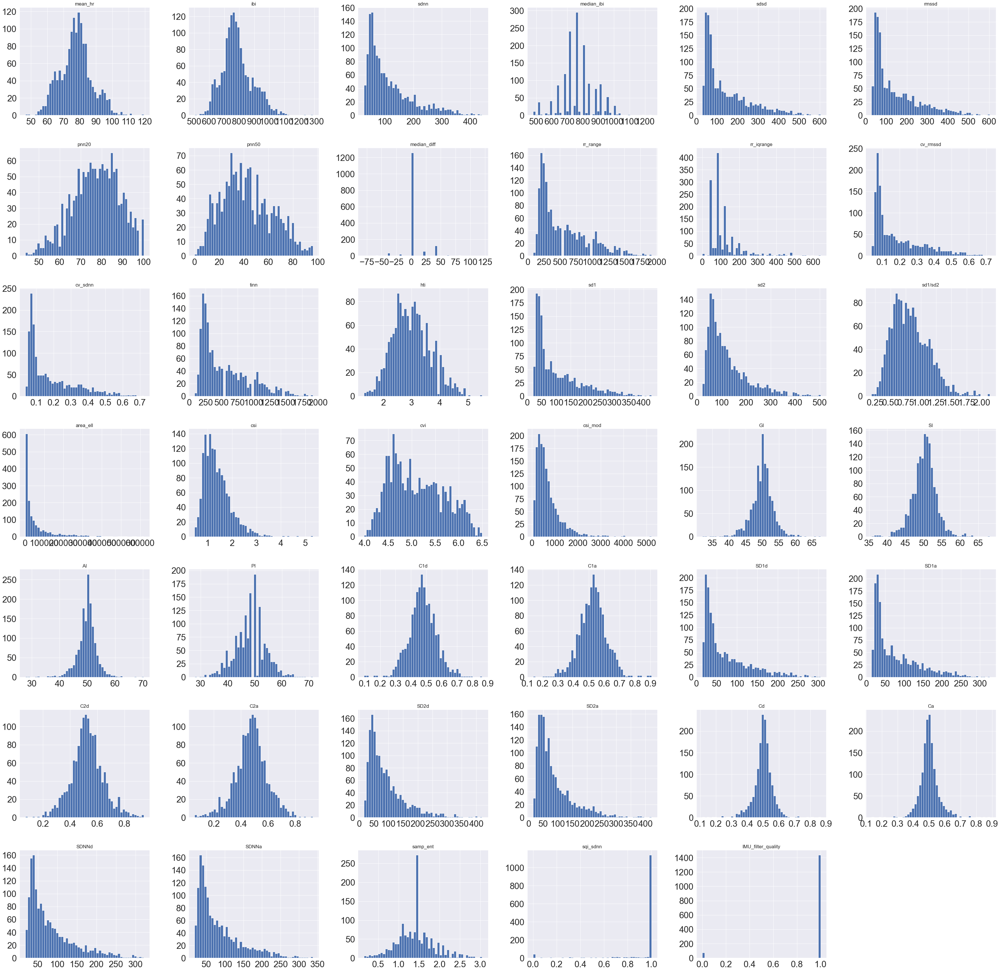

In [34]:
train_df_cl.hist(figsize=(60, 60), bins=50, xlabelsize=30, ylabelsize=30)

# 1.5. Classification Algorithms

Dummy Classifier

In [35]:
dummy_clf = DummyClassifier(strategy="uniform")
dummy_clf.fit(train_x, train_y)
DummyClassifier(strategy='uniform')
dummy_clf.predict(test_x) 
dummy_clf.score(test_x, test_y)

0.32919254658385094

In [36]:

from sklearn.feature_selection import mutual_info_classif
def predict(classifier, train_x, train_y, test_x):
    classifier.fit(train_x, train_y)
    predictions = classifier.predict(test_x)
    return predictions

In [37]:
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score
def evaluate(test_y, predictions):
    cf = confusion_matrix(test_y, predictions, labels = train_y.unique())
    fscore = f1_score(predictions, test_y, average='macro')
    accuracy = accuracy_score(predictions, test_y)
    return cf, fscore, accuracy

Decision Tree Classifier

F1-score: 0.3662548093075236
Accuracy: 0.5387673956262425


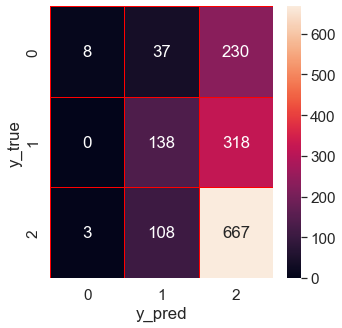

In [38]:
dt = DecisionTreeClassifier(criterion='entropy', max_depth=2, max_features='sqrt',random_state=18)
dt.fit(train_x, train_y)
predictions = predict(dt, train_x, train_y, validation_x)
cf1, fscore, accuracy = evaluate(validation_y, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf1,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()


F1-score: 0.24887879859314813
Accuracy: 0.5496894409937888


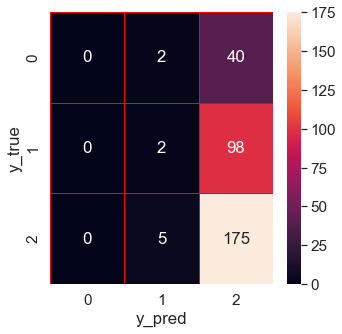

In [39]:
dt.fit(train_x, train_y)
predictions = predict(dt, train_x, train_y, test_x)
cf2, fscore, accuracy = evaluate(test_y, predictions)
fscore_tree_cl=fscore
acc_tree_cl=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf2,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

hyper da ne zaboravime

Random Forest Classifier

F1-score: 0.3398961878363049
Accuracy: 0.5420808482438702


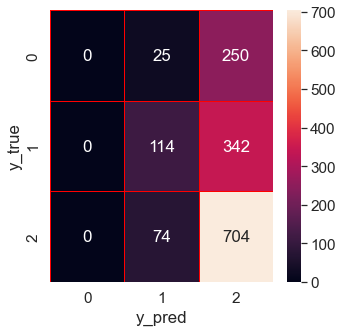

In [40]:
rf = RandomForestClassifier(criterion='entropy', max_depth=2, max_features='log2',min_samples_leaf=8, n_estimators=6, random_state=20)
predictions = predict(rf, train_x, train_y, validation_x)
cf3, fscore, accuracy = evaluate(validation_y, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf3,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.23780895123580495
Accuracy: 0.5527950310559007


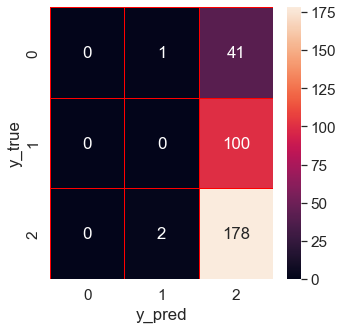

In [41]:
predictions = predict(rf, train_x, train_y, test_x)
cf4, fscore, accuracy = evaluate(test_y, predictions)
fscore_rf_cl=fscore
acc_rf_cl=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf4,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()


In [42]:
level_encoder = LabelEncoder()
test_y_new = level_encoder.fit_transform(test_y)
validation_y_new = level_encoder.fit_transform(validation_y)
train_y_new = level_encoder.fit_transform(train_y)

In [43]:
from sklearn.feature_selection import mutual_info_classif
def predict_new(classifier, train_x, train_y_new, test_x):
    classifier.fit(train_x, train_y_new)
    predictions = classifier.predict(test_x)
    return predictions

In [44]:
def evaluate_new(test_y_new, predictions):
    fscore = f1_score(predictions, test_y_new, average='macro')
    accuracy = accuracy_score(predictions, test_y_new)
    return fscore, accuracy

XGB Classifier

F1-score: 1.0
Accuracy: 1.0


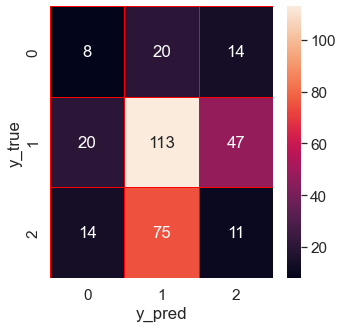

In [45]:

xg = xgb.XGBClassifier(n_estimators = 150, max_depth = 5, learning_rate=0.3, use_label_encoder=False,objective='multi:softmax',eval_metric = 'mlogloss')
predictions = predict_new(xg, train_x, train_y_new, validation_x)
fscore, accuracy = evaluate_new(validation_y_new, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
pred_y = xg.predict(test_x)
cm=confusion_matrix(test_y_new,pred_y)
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.30028579800816674
Accuracy: 0.40993788819875776


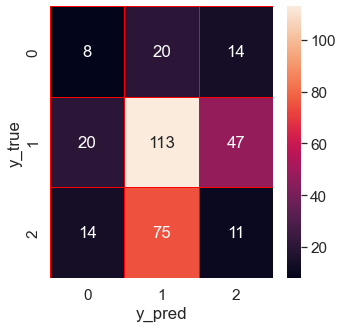

In [46]:

predictions = predict_new(xg, train_x, train_y_new, test_x)
fscore, accuracy = evaluate_new(test_y_new, predictions)
fscore_xgb_cl=fscore
acc_xgb_cl=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
pred1_y = xg.predict(test_x)
cm1=confusion_matrix(test_y_new,pred1_y)
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm1,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

AdaBoost Classifier

F1-score: 0.7955636138453214
Accuracy: 0.7919151756129887


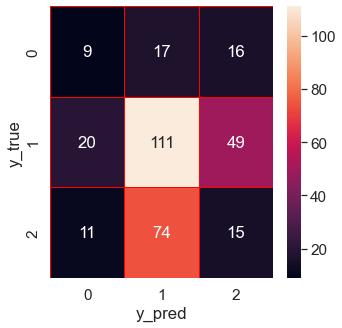

In [47]:
ada = AdaBoostClassifier(n_estimators=1500, random_state=10)
predictions = predict_new(ada, train_x, train_y_new, validation_x)
fscore, accuracy = evaluate_new(validation_y_new, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
pred2_y = ada.predict(test_x)
cm2=confusion_matrix(test_y_new,pred2_y)
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm2,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.3224435647497836
Accuracy: 0.4192546583850932


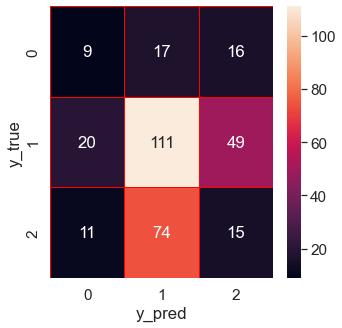

In [48]:

predictions = predict_new(ada, train_x, train_y_new, test_x)
fscore, accuracy = evaluate_new(test_y_new, predictions)
fscore_ada_cl=fscore
acc_ada_cl=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
pred3_y = ada.predict(test_x)
cm3=confusion_matrix(test_y_new,pred3_y)
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm3,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

Suport Vector Machine

F1-score: 1.0
Accuracy: 1.0


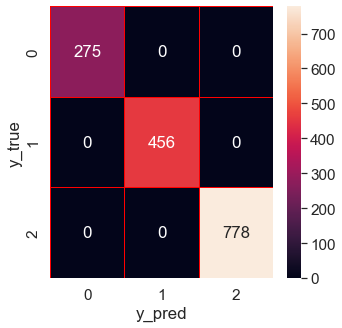

In [49]:
svc = svm.SVC(gamma=0.001)
predictions = predict(svc, train_x, train_y, validation_x)
cf5, fscore, accuracy = evaluate(validation_y, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf5,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()


F1-score: 0.2390438247011952
Accuracy: 0.5590062111801242


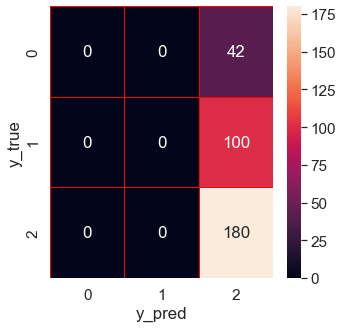

In [50]:
predictions = predict(svc, train_x, train_y, test_x)
cf6, fscore, accuracy = evaluate(test_y, predictions)
fscore_svc_cl=fscore
acc_svc_cl=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf6,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

In [51]:
data_cl = {'Metric':  ['Accuracy','Fscore'],
        'RandomForest': [acc_rf_cl,fscore_rf_cl],
        'Decision Tree': [acc_tree_cl,fscore_tree_cl],
        'SVM': [acc_svc_cl,fscore_svc_cl],
        'AdaBoost' :[acc_ada_cl,fscore_ada_cl],
        'XGB':[acc_xgb_cl,fscore_xgb_cl],
        
        }
comparison_cl = pd.DataFrame (data_cl, columns = ['Metric','RandomForest','Decision Tree', 'SVM','AdaBoost','XGB'])
comparison_cl

,Metric,RandomForest,Decision Tree,SVM,AdaBoost,XGB
0,Accuracy,0.552795,0.549689,0.559006,0.419255,0.409938
1,Fscore,0.237809,0.248879,0.239044,0.322444,0.300286


# 2. Baseline Normalisation

# 2.1 Load data

In [52]:
train_b=pd.read_csv('C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal baseline\\TRAIN_.CSV')
train_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,7.426508,-71.236829,2.728227,-74.0,-1.405728,-1.489693,5.541998,-7.580625,0.0,68.0,...,-0.096568,0.096568,-2.192199,-46.372497,0.088632,0.0,0.0,GroupA\01,7.0,3.0
1,8.244648,-78.236829,-2.002721,-94.0,-14.385708,-14.082146,1.021080,-15.880220,0.0,28.0,...,-0.266478,0.266478,-16.951869,-61.132168,-0.152530,0.0,0.0,GroupA\01,7.0,3.0
2,12.082002,-109.332067,45.006476,-114.0,93.614972,93.534092,-4.920133,-16.630689,0.0,468.0,...,-0.009799,0.009799,32.594238,-11.586061,-0.104740,0.0,0.0,GroupA\01,7.0,3.0
3,16.940493,-145.014606,45.714423,-154.0,86.155211,86.064882,-23.046519,-22.173927,0.0,508.0,...,-0.009207,0.009207,33.069190,-11.111109,-0.405026,0.0,0.0,NaN,NaN,NaN
4,18.996514,-159.014606,55.850027,-194.0,102.587323,102.494203,-25.059506,-25.550550,0.0,508.0,...,-0.008144,0.008144,41.063221,-3.117078,-0.595627,0.0,0.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2062,1.934312,-23.328654,42.702361,-12.0,58.509463,58.448869,10.924976,4.459922,0.0,276.0,...,-0.017641,0.017641,31.308100,4.453350,-0.236792,0.0,0.0,GroupB\09,6.0,8.0
2063,-1.044149,12.558443,41.959520,28.0,57.858145,57.871828,13.183040,1.664223,0.0,276.0,...,0.000639,-0.000639,31.287726,4.432976,0.689970,0.0,0.0,GroupB\09,6.0,8.0
2064,0.316786,-4.215751,34.594257,28.0,31.746455,31.689917,9.849707,4.997556,0.0,236.0,...,-0.024826,0.024826,24.692499,-2.162251,0.977652,0.0,0.0,GroupB\09,6.0,8.0
2065,-0.693315,8.171346,35.382107,28.0,38.769983,38.811300,15.596833,22.813648,0.0,236.0,...,-0.010933,0.010933,25.709107,-1.145643,0.795330,0.0,0.0,NaN,NaN,8.0


In [53]:
del train_b['video']
del train_b['valence']
train_b.dropna(axis=0, inplace=True, subset=['arousal'])
train_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,7.426508,-71.236829,2.728227,-74.0,-1.405728,-1.489693,5.541998,-7.580625,0.0,68.0,...,-3.712754,12.782991,-0.096568,0.096568,-2.192199,-46.372497,0.088632,0.0,0.0,7.0
1,8.244648,-78.236829,-2.002721,-94.0,-14.385708,-14.082146,1.021080,-15.880220,0.0,28.0,...,-20.717539,11.058579,-0.266478,0.266478,-16.951869,-61.132168,-0.152530,0.0,0.0,7.0
2,12.082002,-109.332067,45.006476,-114.0,93.614972,93.534092,-4.920133,-16.630689,0.0,468.0,...,21.892488,23.059470,-0.009799,0.009799,32.594238,-11.586061,-0.104740,0.0,0.0,7.0
8,9.867234,-91.724633,-10.985524,-74.0,-20.981622,-21.025918,-3.273792,-18.764836,0.0,-52.0,...,-6.816276,-7.539456,0.018602,-0.018602,-7.638811,-51.819110,-0.284208,0.0,0.0,8.0
9,10.835065,-99.529511,-25.905459,-114.0,-26.721170,-26.800087,-8.273792,-26.264836,0.0,-92.0,...,-22.243711,-20.761698,-0.012460,0.012460,-18.740740,-62.921038,-0.413826,0.0,0.0,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,-3.839417,49.171346,8.890119,68.0,4.859881,4.962506,4.473363,7.685728,0.0,36.0,...,11.661081,5.729698,0.070736,-0.070736,8.400911,-18.453839,-0.203848,0.0,0.0,2.0
2059,-4.920368,64.171346,0.542709,68.0,5.149614,5.080454,6.516373,1.664223,0.0,-4.0,...,0.426149,-0.488402,0.002131,-0.002131,0.724948,-26.129802,-0.263461,0.0,0.0,2.0
2062,1.934312,-23.328654,42.702361,-12.0,58.509463,58.448869,10.924976,4.459922,0.0,276.0,...,31.959583,37.706537,-0.017641,0.017641,31.308100,4.453350,-0.236792,0.0,0.0,6.0
2063,-1.044149,12.558443,41.959520,28.0,57.858145,57.871828,13.183040,1.664223,0.0,276.0,...,31.233691,35.064011,0.000639,-0.000639,31.287726,4.432976,0.689970,0.0,0.0,6.0


In [54]:
train_b_cl=train_b.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
train_b_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,7.426508,-71.236829,2.728227,-74.0,-1.405728,-1.489693,5.541998,-7.580625,0.0,68.0,...,-3.712754,12.782991,-0.096568,0.096568,-2.192199,-46.372497,0.088632,0.0,0.0,high
1,8.244648,-78.236829,-2.002721,-94.0,-14.385708,-14.082146,1.021080,-15.880220,0.0,28.0,...,-20.717539,11.058579,-0.266478,0.266478,-16.951869,-61.132168,-0.152530,0.0,0.0,high
2,12.082002,-109.332067,45.006476,-114.0,93.614972,93.534092,-4.920133,-16.630689,0.0,468.0,...,21.892488,23.059470,-0.009799,0.009799,32.594238,-11.586061,-0.104740,0.0,0.0,high
8,9.867234,-91.724633,-10.985524,-74.0,-20.981622,-21.025918,-3.273792,-18.764836,0.0,-52.0,...,-6.816276,-7.539456,0.018602,-0.018602,-7.638811,-51.819110,-0.284208,0.0,0.0,high
9,10.835065,-99.529511,-25.905459,-114.0,-26.721170,-26.800087,-8.273792,-26.264836,0.0,-92.0,...,-22.243711,-20.761698,-0.012460,0.012460,-18.740740,-62.921038,-0.413826,0.0,0.0,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,-3.839417,49.171346,8.890119,68.0,4.859881,4.962506,4.473363,7.685728,0.0,36.0,...,11.661081,5.729698,0.070736,-0.070736,8.400911,-18.453839,-0.203848,0.0,0.0,low
2059,-4.920368,64.171346,0.542709,68.0,5.149614,5.080454,6.516373,1.664223,0.0,-4.0,...,0.426149,-0.488402,0.002131,-0.002131,0.724948,-26.129802,-0.263461,0.0,0.0,low
2062,1.934312,-23.328654,42.702361,-12.0,58.509463,58.448869,10.924976,4.459922,0.0,276.0,...,31.959583,37.706537,-0.017641,0.017641,31.308100,4.453350,-0.236792,0.0,0.0,medium
2063,-1.044149,12.558443,41.959520,28.0,57.858145,57.871828,13.183040,1.664223,0.0,276.0,...,31.233691,35.064011,0.000639,-0.000639,31.287726,4.432976,0.689970,0.0,0.0,medium


In [55]:
validation_b=pd.read_csv('C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal baseline\\VALIDATION_.CSV')
validation_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,4.772748,-22.070311,38.855736,-8.0,56.157579,56.148291,3.380219,4.078232,0.0,400.0,...,0.006656,-0.006656,28.450481,7.451438,0.011757,0.000000,0.0,NaN,NaN,NaN
1,-7.115546,36.545073,160.686770,-8.0,178.084973,178.074735,6.849299,12.223029,0.0,760.0,...,-0.193069,0.193069,86.630918,65.631875,0.084056,-0.226730,0.0,NaN,NaN,NaN
2,-13.588625,74.436965,215.592874,-8.0,260.799836,260.795506,5.994598,19.274311,0.0,760.0,...,-0.141403,0.141403,129.257359,108.258315,-0.562166,-0.537460,0.0,NaN,NaN,NaN
3,-9.906032,52.288663,205.739384,-8.0,202.416119,203.437711,-4.824116,15.326942,0.0,760.0,...,-0.267498,0.267498,86.674491,65.675448,-0.720906,-0.481696,0.0,GroupB\07,7.0,7.0
4,2.600254,-12.269741,62.047356,-8.0,82.660121,83.000578,1.382438,9.368650,0.0,400.0,...,-0.132874,0.132874,29.030769,8.031726,-0.108958,0.000000,0.0,GroupB\07,7.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
484,-1.075700,9.534446,110.913723,-12.0,176.963987,177.017968,14.619683,13.067499,38.0,640.0,...,-0.021013,0.021013,69.127002,17.516477,0.149533,-0.184500,0.0,GroupA\04,5.0,6.0
485,0.804814,-10.465554,45.164196,-32.0,67.579642,67.579980,20.333969,10.210356,38.0,160.0,...,0.042602,-0.042602,36.090752,-15.519773,0.184769,0.000000,0.0,GroupA\04,5.0,6.0
486,1.453022,-17.132221,68.294853,-12.0,102.061563,101.990419,11.762540,15.924642,-2.0,280.0,...,0.034383,-0.034383,52.588749,0.978225,0.149533,0.000000,0.0,NaN,NaN,NaN
487,4.917253,-50.933390,69.855237,-72.0,128.436717,128.361805,9.832038,13.144719,-42.0,320.0,...,-0.018047,0.018047,48.487855,-3.122670,0.149533,0.000000,0.0,GroupA\05,3.0,4.0


In [56]:
del validation_b['video']
del validation_b['valence']
validation_b.dropna(axis=0, inplace=True, subset=['arousal'])
validation_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
3,-9.906032,52.288663,205.739384,-8.0,202.416119,203.437711,-4.824116,15.326942,0.0,760.0,...,82.079005,220.462071,-0.267498,0.267498,86.674491,65.675448,-0.720906,-0.481696,0.0,7.0
4,2.600254,-12.269741,62.047356,-8.0,82.660121,83.000578,1.382438,9.368650,0.0,400.0,...,26.141386,40.410577,-0.132874,0.132874,29.030769,8.031726,-0.108958,0.000000,0.0,7.0
5,5.673273,-26.026355,4.187451,-8.0,-1.865540,-1.844612,-4.106412,-0.271144,0.0,40.0,...,6.113934,4.633864,-0.005015,0.005015,2.744788,-18.254255,-0.195996,0.000000,0.0,7.0
8,-4.988581,25.098265,131.346300,-8.0,166.826020,166.966272,35.221651,29.056919,0.0,480.0,...,103.813977,94.643332,0.015398,-0.015398,93.648591,72.649547,0.407877,-0.060683,0.0,9.0
9,-5.470464,27.651456,92.346579,-8.0,119.199975,119.249223,22.178173,22.535180,0.0,440.0,...,57.567063,84.524181,-0.063643,0.063643,60.497884,39.498841,0.225555,0.000000,0.0,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,6.940257,-69.354443,93.875504,-72.0,195.456269,195.391152,11.762540,13.067499,-2.0,760.0,...,56.441701,21.523002,0.014468,-0.014468,70.143034,18.532509,0.149533,-0.088076,0.0,5.0
484,-1.075700,9.534446,110.913723,-12.0,176.963987,177.017968,14.619683,13.067499,38.0,640.0,...,66.331147,50.694045,-0.021013,0.021013,69.127002,17.516477,0.149533,-0.184500,0.0,5.0
485,0.804814,-10.465554,45.164196,-32.0,67.579642,67.579980,20.333969,10.210356,38.0,160.0,...,38.804371,27.399778,0.042602,-0.042602,36.090752,-15.519773,0.184769,0.000000,0.0,5.0
487,4.917253,-50.933390,69.855237,-72.0,128.436717,128.361805,9.832038,13.144719,-42.0,320.0,...,29.088524,50.552599,-0.018047,0.018047,48.487855,-3.122670,0.149533,0.000000,0.0,3.0


In [57]:
validation_b_cl=validation_b.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
validation_b_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
3,-9.906032,52.288663,205.739384,-8.0,202.416119,203.437711,-4.824116,15.326942,0.0,760.0,...,82.079005,220.462071,-0.267498,0.267498,86.674491,65.675448,-0.720906,-0.481696,0.0,high
4,2.600254,-12.269741,62.047356,-8.0,82.660121,83.000578,1.382438,9.368650,0.0,400.0,...,26.141386,40.410577,-0.132874,0.132874,29.030769,8.031726,-0.108958,0.000000,0.0,high
5,5.673273,-26.026355,4.187451,-8.0,-1.865540,-1.844612,-4.106412,-0.271144,0.0,40.0,...,6.113934,4.633864,-0.005015,0.005015,2.744788,-18.254255,-0.195996,0.000000,0.0,high
8,-4.988581,25.098265,131.346300,-8.0,166.826020,166.966272,35.221651,29.056919,0.0,480.0,...,103.813977,94.643332,0.015398,-0.015398,93.648591,72.649547,0.407877,-0.060683,0.0,high
9,-5.470464,27.651456,92.346579,-8.0,119.199975,119.249223,22.178173,22.535180,0.0,440.0,...,57.567063,84.524181,-0.063643,0.063643,60.497884,39.498841,0.225555,0.000000,0.0,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,6.940257,-69.354443,93.875504,-72.0,195.456269,195.391152,11.762540,13.067499,-2.0,760.0,...,56.441701,21.523002,0.014468,-0.014468,70.143034,18.532509,0.149533,-0.088076,0.0,medium
484,-1.075700,9.534446,110.913723,-12.0,176.963987,177.017968,14.619683,13.067499,38.0,640.0,...,66.331147,50.694045,-0.021013,0.021013,69.127002,17.516477,0.149533,-0.184500,0.0,medium
485,0.804814,-10.465554,45.164196,-32.0,67.579642,67.579980,20.333969,10.210356,38.0,160.0,...,38.804371,27.399778,0.042602,-0.042602,36.090752,-15.519773,0.184769,0.000000,0.0,medium
487,4.917253,-50.933390,69.855237,-72.0,128.436717,128.361805,9.832038,13.144719,-42.0,320.0,...,29.088524,50.552599,-0.018047,0.018047,48.487855,-3.122670,0.149533,0.000000,0.0,low


In [58]:
test_b=pd.read_csv('C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal baseline\\TEST_.CSV')
test_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,8.005911,-71.023989,-43.242133,-84.0,-11.358008,-11.386604,1.269841,-7.629987,0.0,-120.0,...,-0.000881,0.000881,-30.980634,-98.033627,0.262940,0.000000,0.0,GroupD\16,5.0,2.0
1,6.432986,-58.194721,-27.206996,-44.0,-10.102204,-10.046573,3.128816,-14.745372,0.0,-80.0,...,0.027514,-0.027514,-18.401784,-85.454777,0.500612,0.000000,0.0,NaN,NaN,NaN
2,5.716813,-52.194721,-26.824890,-44.0,-11.151927,-11.182865,3.128816,-17.309474,0.0,-80.0,...,0.005304,-0.005304,-18.830091,-85.883084,-0.102679,0.000000,0.0,NaN,NaN,NaN
3,6.192913,-56.194721,-33.610612,-44.0,-23.281811,-23.262033,-7.127595,-19.873577,0.0,-80.0,...,-0.003857,0.003857,-24.889915,-91.942908,-0.071907,0.000000,0.0,GroupD\17,7.0,2.0
4,8.189040,-72.487404,-49.801579,-84.0,-14.981636,-14.972397,-8.730159,-7.629987,0.0,-120.0,...,-0.021849,0.021849,-36.760977,-103.813970,0.015104,0.000000,0.0,GroupD\17,7.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,6.460100,-77.750000,15.855108,-96.0,53.365578,53.382966,5.540879,15.181799,0.0,172.0,...,0.000054,-0.000054,11.909792,-46.328065,0.097595,0.000000,0.0,GroupD\20,2.0,1.0
480,6.437974,-77.507576,-23.604123,-56.0,-41.988654,-42.014387,-5.342742,-5.292339,0.0,-148.0,...,-0.002176,0.002176,-17.625884,-75.863741,0.458254,0.000000,0.0,GroupD\20,2.0,1.0
481,4.076156,-50.769608,-29.897426,-56.0,-39.980729,-40.007904,-4.490469,-6.239308,0.0,-148.0,...,0.027470,-0.027470,-20.851737,-79.089594,0.052789,0.000000,0.0,GroupD\20,2.0,1.0
482,2.901488,-36.803763,85.534601,-56.0,59.207763,59.869778,-0.551075,-3.209005,0.0,492.0,...,-0.111815,0.111815,43.071197,-15.166661,0.170572,-0.099733,0.0,GroupD\20,2.0,1.0


In [59]:
del test_b['video']
del test_b['valence']
test_b.dropna(axis=0, inplace=True, subset=['arousal'])
test_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,8.005911,-71.023989,-43.242133,-84.0,-11.358008,-11.386604,1.269841,-7.629987,0.0,-120.0,...,-44.061204,-45.261815,-0.000881,0.000881,-30.980634,-98.033627,0.262940,0.000000,0.0,5.0
3,6.192913,-56.194721,-33.610612,-44.0,-23.281811,-23.262033,-7.127595,-19.873577,0.0,-80.0,...,-33.142767,-31.345854,-0.003857,0.003857,-24.889915,-91.942908,-0.071907,0.000000,0.0,7.0
4,8.189040,-72.487404,-49.801579,-84.0,-14.981636,-14.972397,-8.730159,-7.629987,0.0,-120.0,...,-53.346528,-50.419973,-0.021849,0.021849,-36.760977,-103.813970,0.015104,0.000000,0.0,7.0
5,10.682277,-91.813769,-43.244653,-84.0,-1.680130,-1.680888,-10.254549,-0.861694,0.0,-80.0,...,-51.074798,-46.245440,-0.042358,0.042358,-32.941345,-99.994338,0.392398,0.000000,0.0,7.0
8,3.265332,-30.861388,-43.552580,-44.0,-14.910319,-14.930140,-8.072264,-3.814198,0.0,-40.0,...,-47.625812,-40.369504,-0.047526,0.047526,-32.930069,-99.983062,0.050195,0.000000,0.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,6.460100,-77.750000,15.855108,-96.0,53.365578,53.382966,5.540879,15.181799,0.0,172.0,...,1.334924,-6.219079,0.000054,-0.000054,11.909792,-46.328065,0.097595,0.000000,0.0,2.0
480,6.437974,-77.507576,-23.604123,-56.0,-41.988654,-42.014387,-5.342742,-5.292339,0.0,-148.0,...,-19.941768,-10.037100,-0.002176,0.002176,-17.625884,-75.863741,0.458254,0.000000,0.0,2.0
481,4.076156,-50.769608,-29.897426,-56.0,-39.980729,-40.007904,-4.490469,-6.239308,0.0,-148.0,...,-25.289138,-19.619792,0.027470,-0.027470,-20.851737,-79.089594,0.052789,0.000000,0.0,2.0
482,2.901488,-36.803763,85.534601,-56.0,59.207763,59.869778,-0.551075,-3.209005,0.0,492.0,...,28.890773,109.600259,-0.111815,0.111815,43.071197,-15.166661,0.170572,-0.099733,0.0,2.0


In [60]:
test_b_cl=test_b.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
test_b_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,arousal
0,8.005911,-71.023989,-43.242133,-84.0,-11.358008,-11.386604,1.269841,-7.629987,0.0,-120.0,...,-44.061204,-45.261815,-0.000881,0.000881,-30.980634,-98.033627,0.262940,0.000000,0.0,medium
3,6.192913,-56.194721,-33.610612,-44.0,-23.281811,-23.262033,-7.127595,-19.873577,0.0,-80.0,...,-33.142767,-31.345854,-0.003857,0.003857,-24.889915,-91.942908,-0.071907,0.000000,0.0,high
4,8.189040,-72.487404,-49.801579,-84.0,-14.981636,-14.972397,-8.730159,-7.629987,0.0,-120.0,...,-53.346528,-50.419973,-0.021849,0.021849,-36.760977,-103.813970,0.015104,0.000000,0.0,high
5,10.682277,-91.813769,-43.244653,-84.0,-1.680130,-1.680888,-10.254549,-0.861694,0.0,-80.0,...,-51.074798,-46.245440,-0.042358,0.042358,-32.941345,-99.994338,0.392398,0.000000,0.0,high
8,3.265332,-30.861388,-43.552580,-44.0,-14.910319,-14.930140,-8.072264,-3.814198,0.0,-40.0,...,-47.625812,-40.369504,-0.047526,0.047526,-32.930069,-99.983062,0.050195,0.000000,0.0,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,6.460100,-77.750000,15.855108,-96.0,53.365578,53.382966,5.540879,15.181799,0.0,172.0,...,1.334924,-6.219079,0.000054,-0.000054,11.909792,-46.328065,0.097595,0.000000,0.0,low
480,6.437974,-77.507576,-23.604123,-56.0,-41.988654,-42.014387,-5.342742,-5.292339,0.0,-148.0,...,-19.941768,-10.037100,-0.002176,0.002176,-17.625884,-75.863741,0.458254,0.000000,0.0,low
481,4.076156,-50.769608,-29.897426,-56.0,-39.980729,-40.007904,-4.490469,-6.239308,0.0,-148.0,...,-25.289138,-19.619792,0.027470,-0.027470,-20.851737,-79.089594,0.052789,0.000000,0.0,low
482,2.901488,-36.803763,85.534601,-56.0,59.207763,59.869778,-0.551075,-3.209005,0.0,492.0,...,28.890773,109.600259,-0.111815,0.111815,43.071197,-15.166661,0.170572,-0.099733,0.0,low


In [61]:
train_x_b=train_b_cl.drop(['arousal'], axis=1)
train_x_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality
0,7.426508,-71.236829,2.728227,-74.0,-1.405728,-1.489693,5.541998,-7.580625,0.0,68.0,...,0.135827,-3.712754,12.782991,-0.096568,0.096568,-2.192199,-46.372497,0.088632,0.0,0.0
1,8.244648,-78.236829,-2.002721,-94.0,-14.385708,-14.082146,1.021080,-15.880220,0.0,28.0,...,0.289828,-20.717539,11.058579,-0.266478,0.266478,-16.951869,-61.132168,-0.152530,0.0,0.0
2,12.082002,-109.332067,45.006476,-114.0,93.614972,93.534092,-4.920133,-16.630689,0.0,468.0,...,0.008432,21.892488,23.059470,-0.009799,0.009799,32.594238,-11.586061,-0.104740,0.0,0.0
8,9.867234,-91.724633,-10.985524,-74.0,-20.981622,-21.025918,-3.273792,-18.764836,0.0,-52.0,...,-0.012609,-6.816276,-7.539456,0.018602,-0.018602,-7.638811,-51.819110,-0.284208,0.0,0.0
9,10.835065,-99.529511,-25.905459,-114.0,-26.721170,-26.800087,-8.273792,-26.264836,0.0,-92.0,...,0.010968,-22.243711,-20.761698,-0.012460,0.012460,-18.740740,-62.921038,-0.413826,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,-3.839417,49.171346,8.890119,68.0,4.859881,4.962506,4.473363,7.685728,0.0,36.0,...,-0.062608,11.661081,5.729698,0.070736,-0.070736,8.400911,-18.453839,-0.203848,0.0,0.0
2059,-4.920368,64.171346,0.542709,68.0,5.149614,5.080454,6.516373,1.664223,0.0,-4.0,...,-0.014403,0.426149,-0.488402,0.002131,-0.002131,0.724948,-26.129802,-0.263461,0.0,0.0
2062,1.934312,-23.328654,42.702361,-12.0,58.509463,58.448869,10.924976,4.459922,0.0,276.0,...,0.061035,31.959583,37.706537,-0.017641,0.017641,31.308100,4.453350,-0.236792,0.0,0.0
2063,-1.044149,12.558443,41.959520,28.0,57.858145,57.871828,13.183040,1.664223,0.0,276.0,...,0.047199,31.233691,35.064011,0.000639,-0.000639,31.287726,4.432976,0.689970,0.0,0.0


In [62]:
validation_x_b=validation_b_cl.drop(['arousal'], axis=1)
validation_x_b

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality
3,-9.906032,52.288663,205.739384,-8.0,202.416119,203.437711,-4.824116,15.326942,0.0,760.0,...,0.320488,82.079005,220.462071,-0.267498,0.267498,86.674491,65.675448,-0.720906,-0.481696,0.0
4,2.600254,-12.269741,62.047356,-8.0,82.660121,83.000578,1.382438,9.368650,0.0,400.0,...,0.107606,26.141386,40.410577,-0.132874,0.132874,29.030769,8.031726,-0.108958,0.000000,0.0
5,5.673273,-26.026355,4.187451,-8.0,-1.865540,-1.844612,-4.106412,-0.271144,0.0,40.0,...,-0.030884,6.113934,4.633864,-0.005015,0.005015,2.744788,-18.254255,-0.195996,0.000000,0.0
8,-4.988581,25.098265,131.346300,-8.0,166.826020,166.966272,35.221651,29.056919,0.0,480.0,...,-0.055400,103.813977,94.643332,0.015398,-0.015398,93.648591,72.649547,0.407877,-0.060683,0.0
9,-5.470464,27.651456,92.346579,-8.0,119.199975,119.249223,22.178173,22.535180,0.0,440.0,...,0.120993,57.567063,84.524181,-0.063643,0.063643,60.497884,39.498841,0.225555,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,6.940257,-69.354443,93.875504,-72.0,195.456269,195.391152,11.762540,13.067499,-2.0,760.0,...,-0.163470,56.441701,21.523002,0.014468,-0.014468,70.143034,18.532509,0.149533,-0.088076,0.0
484,-1.075700,9.534446,110.913723,-12.0,176.963987,177.017968,14.619683,13.067499,38.0,640.0,...,-0.060515,66.331147,50.694045,-0.021013,0.021013,69.127002,17.516477,0.149533,-0.184500,0.0
485,0.804814,-10.465554,45.164196,-32.0,67.579642,67.579980,20.333969,10.210356,38.0,160.0,...,-0.055943,38.804371,27.399778,0.042602,-0.042602,36.090752,-15.519773,0.184769,0.000000,0.0
487,4.917253,-50.933390,69.855237,-72.0,128.436717,128.361805,9.832038,13.144719,-42.0,320.0,...,0.107479,29.088524,50.552599,-0.018047,0.018047,48.487855,-3.122670,0.149533,0.000000,0.0


In [63]:
test_x_b=test_b_cl.drop(['arousal'], axis=1)
test_x_b


,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality
0,8.005911,-71.023989,-43.242133,-84.0,-11.358008,-11.386604,1.269841,-7.629987,0.0,-120.0,...,-0.024219,-44.061204,-45.261815,-0.000881,0.000881,-30.980634,-98.033627,0.262940,0.000000,0.0
3,6.192913,-56.194721,-33.610612,-44.0,-23.281811,-23.262033,-7.127595,-19.873577,0.0,-80.0,...,0.009519,-33.142767,-31.345854,-0.003857,0.003857,-24.889915,-91.942908,-0.071907,0.000000,0.0
4,8.189040,-72.487404,-49.801579,-84.0,-14.981636,-14.972397,-8.730159,-7.629987,0.0,-120.0,...,0.022507,-53.346528,-50.419973,-0.021849,0.021849,-36.760977,-103.813970,0.015104,0.000000,0.0
5,10.682277,-91.813769,-43.244653,-84.0,-1.680130,-1.680888,-10.254549,-0.861694,0.0,-80.0,...,0.044603,-51.074798,-46.245440,-0.042358,0.042358,-32.941345,-99.994338,0.392398,0.000000,0.0
8,3.265332,-30.861388,-43.552580,-44.0,-14.910319,-14.930140,-8.072264,-3.814198,0.0,-40.0,...,0.067503,-47.625812,-40.369504,-0.047526,0.047526,-32.930069,-99.983062,0.050195,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,6.460100,-77.750000,15.855108,-96.0,53.365578,53.382966,5.540879,15.181799,0.0,172.0,...,-0.056939,1.334924,-6.219079,0.000054,-0.000054,11.909792,-46.328065,0.097595,0.000000,0.0
480,6.437974,-77.507576,-23.604123,-56.0,-41.988654,-42.014387,-5.342742,-5.292339,0.0,-148.0,...,0.064266,-19.941768,-10.037100,-0.002176,0.002176,-17.625884,-75.863741,0.458254,0.000000,0.0
481,4.076156,-50.769608,-29.897426,-56.0,-39.980729,-40.007904,-4.490469,-6.239308,0.0,-148.0,...,0.012971,-25.289138,-19.619792,0.027470,-0.027470,-20.851737,-79.089594,0.052789,0.000000,0.0
482,2.901488,-36.803763,85.534601,-56.0,59.207763,59.869778,-0.551075,-3.209005,0.0,492.0,...,0.330040,28.890773,109.600259,-0.111815,0.111815,43.071197,-15.166661,0.170572,-0.099733,0.0


In [64]:
train_y_b=train_b_cl["arousal"]
train_y_b

0         high
1         high
2         high
8         high
9         high
         ...  
2058       low
2059       low
2062    medium
2063    medium
2064    medium
Name: arousal, Length: 1509, dtype: object

In [65]:
validation_y_b=validation_b_cl["arousal"]
validation_y_b

3        high
4        high
5        high
8        high
9        high
        ...  
483    medium
484    medium
485    medium
487       low
488       low
Name: arousal, Length: 358, dtype: object

In [66]:
test_y_b=test_b_cl["arousal"]
test_y_b


0      medium
3        high
4        high
5        high
8         low
        ...  
479       low
480       low
481       low
482       low
483       low
Name: arousal, Length: 322, dtype: object

# 2.2 Data visualisation

In [67]:
def get_percentage_cnt(df, col):   
    t1 = pd.DataFrame(df.groupby(col)[col].count().rename('cnt%'))
    t1.reset_index(inplace=True)
    t1['cnt%'] = round((t1['cnt%'] * 100) / t1['cnt%'].sum(),2)
    return t1
def myplot(x, y, df):
    ax = sns.barplot(x=x, y=y, data=df)
    for p in ax.patches:
        ax.annotate('{0:.1f}%'.format(p.get_height()), (p.get_x()+0.1, p.get_height()))

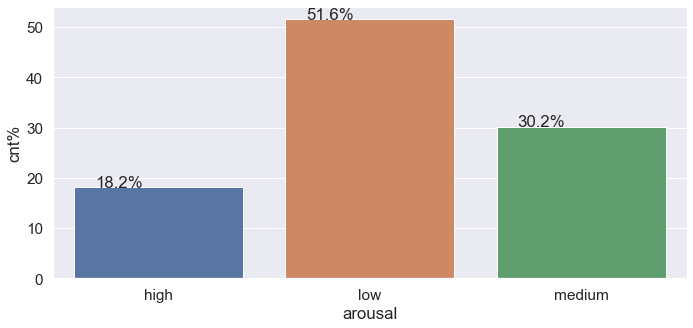

In [68]:
plt.figure(figsize=(25,5))
dual_categories = ['arousal']
plt_cnt = 1;
for feature in dual_categories:
    plt.subplot(1,2,plt_cnt)
    tempdf = get_percentage_cnt(train_b_cl, feature)
    myplot(feature, 'cnt%', tempdf)
    plt_cnt += 1
plt.show()

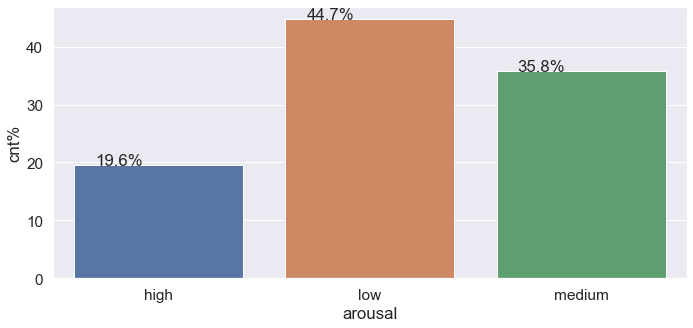

In [69]:
plt.figure(figsize=(25,5))
dual_categories = ['arousal']
plt_cnt = 1;
for feature in dual_categories:
    plt.subplot(1,2,plt_cnt)
    tempdf = get_percentage_cnt(validation_b_cl, feature)
    myplot(feature, 'cnt%', tempdf)
    plt_cnt += 1
plt.show()

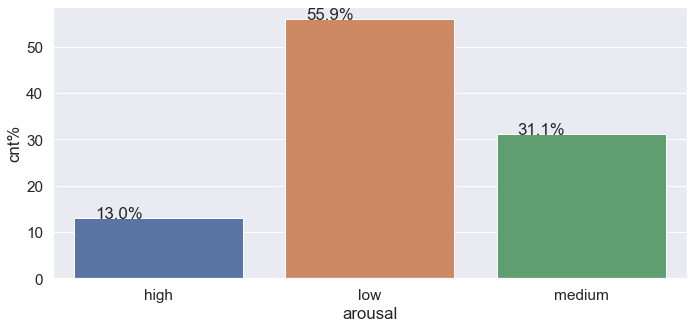

In [70]:
plt.figure(figsize=(25,5))

dual_categories = ['arousal']

plt_cnt = 1;
for feature in dual_categories:
    plt.subplot(1,2,plt_cnt)
    tempdf = get_percentage_cnt(test_b_cl, feature)
    myplot(feature, 'cnt%', tempdf)
    plt_cnt += 1

plt.show()

# 2.3. Standardisation

In [71]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
print(scaler.fit(train_x_b))
print(scaler.transform(train_x_b))

StandardScaler()
[[ 0.80418155 -0.7156805  -0.42364137 ...  0.41743365  0.39206611
   0.22546764]
 [ 0.93124392 -0.81984304 -0.4904234  ... -0.08160961  0.39206611
   0.22546764]
 [ 1.52721003 -1.28255146  0.17315795 ...  0.01728492  0.39206611
   0.22546764]
 ...
 [-0.0487923  -0.0027895   0.14063309 ... -0.25597516  0.39206611
   0.22546764]
 [-0.51136675  0.53122352  0.13014715 ...  1.66179891  0.39206611
   0.22546764]
 [-0.30000472  0.28161744  0.02617917 ...  2.25710731  0.39206611
   0.22546764]]


In [72]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
print(scaler.fit(validation_x_b))
print(scaler.transform(validation_x_b))

StandardScaler()
[[-0.95289285  0.49089409  1.57024789 ... -1.12117296 -1.0278385
   0.318651  ]
 [ 0.68081327 -0.4957261   0.03932183 ...  0.09757302  0.52740514
   0.318651  ]
 [ 1.08224429 -0.70596291 -0.57713015 ... -0.07577016  0.52740514
   0.318651  ]
 ...
 [ 0.44627356 -0.46815343 -0.14055502 ...  0.68255595  0.52740514
   0.318651  ]
 [ 0.98348468 -1.08660713  0.12250869 ...  0.61237926  0.52740514
   0.318651  ]
 [ 1.41324307 -1.5374764   0.36878647 ...  2.71112227  0.25956784
   0.318651  ]]


In [73]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
print(scaler.fit(test_x_b))
print(scaler.transform(test_x_b))

StandardScaler()
[[ 1.68702949 -1.35616555 -1.01511229 ...  0.21050004  0.44441027
   0.05581456]
 [ 1.4141365  -1.17453966 -0.8825298  ... -0.46927514  0.44441027
   0.05581456]
 [ 1.71459405 -1.37408916 -1.10540621 ... -0.29263303  0.44441027
   0.05581456]
 ...
 [ 1.09552179 -1.10809397 -0.83141601 ... -0.21612934  0.44441027
   0.05581456]
 [ 0.91871048 -0.93704312  0.75756107 ...  0.02298242  0.08133906
   0.05581456]
 [ 0.42344376 -0.42605969  1.91025409 ... -1.50725238 -1.64386145
   0.05581456]]


# 2.4.Corealation matrix

In [74]:
sns.set(font_scale=6.5)
correlation=train_b.corr()
plt.figure(figsize=(250,130))
sns.heatmap(correlation, annot=True, fmt='.3f')
plt.show()

<AxesSubplot:xlabel='AI', ylabel='GI'>

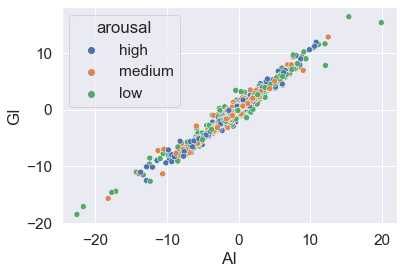

In [75]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['AI'], y=train_b_cl['GI'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='mean_hr', ylabel='ibi'>

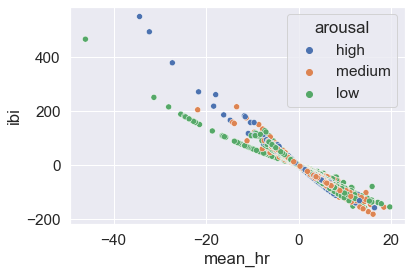

In [76]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['mean_hr'], y=train_b_cl['ibi'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='hti', ylabel='samp_ent'>

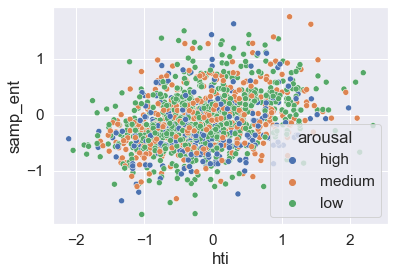

In [77]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['hti'], y=train_b_cl['samp_ent'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='mean_hr', ylabel='sqi_sdnn'>

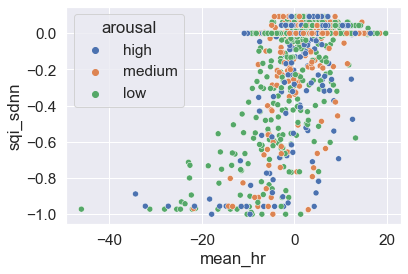

In [78]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['mean_hr'], y=train_b_cl['sqi_sdnn'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='sdnn', ylabel='SDNNa'>

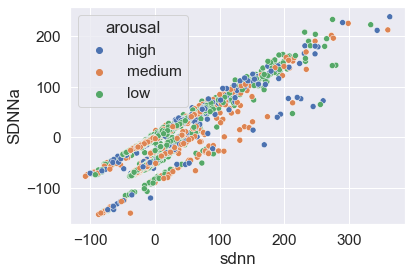

In [79]:

sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['sdnn'], y=train_b_cl['SDNNa'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='pnn20', ylabel='pnn50'>

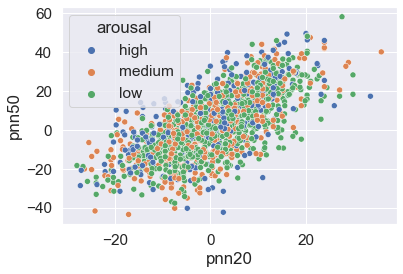

In [80]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['pnn20'], y=train_b_cl['pnn50'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='cvi', ylabel='sdnn'>

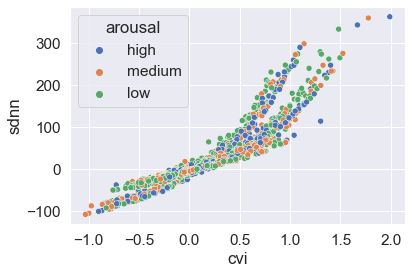

In [81]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['cvi'], y=train_b_cl['sdnn'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='sdnn', ylabel='median_ibi'>

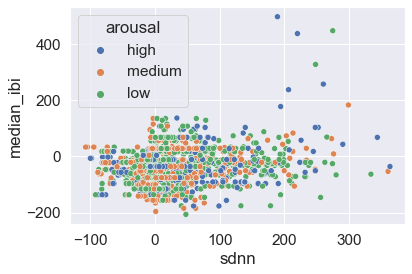

In [82]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['sdnn'], y=train_b_cl['median_ibi'], hue=train_b_cl['arousal'])

<AxesSubplot:xlabel='sd1', ylabel='SD1d'>

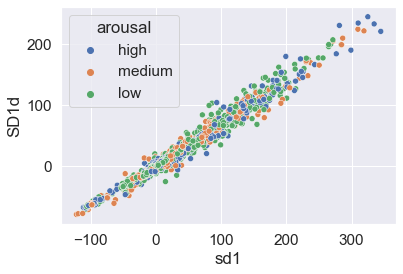

In [83]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_b_cl['sd1'], y=train_b_cl['SD1d'], hue=train_b_cl['arousal'])

(array([0, 1, 2]),
 [Text(0, 0, 'high'), Text(1, 0, 'medium'), Text(2, 0, 'low')])

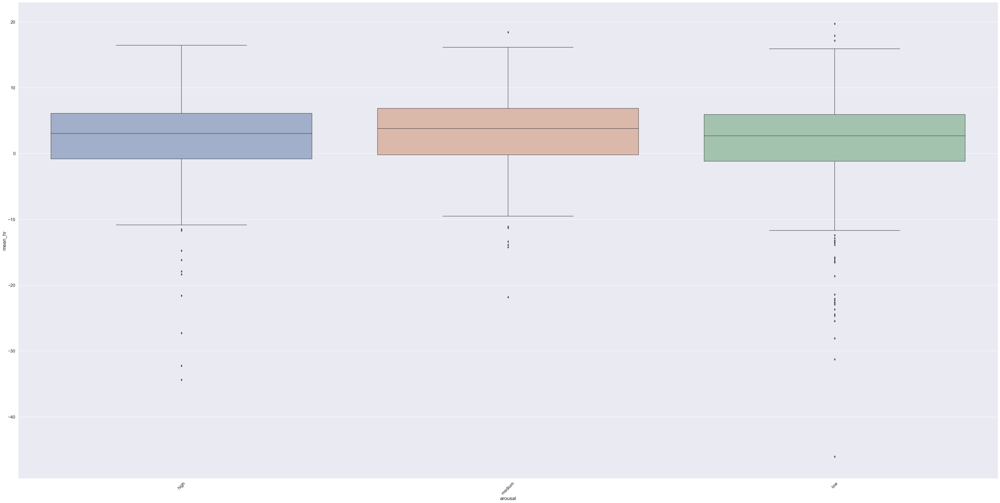

In [84]:
plt.figure(figsize = (60, 30))
ax = sns.boxplot(x='arousal', y='mean_hr', data=train_b_cl)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

array([[<AxesSubplot:title={'center':'mean_hr'}>,
        <AxesSubplot:title={'center':'ibi'}>,
        <AxesSubplot:title={'center':'sdnn'}>,
        <AxesSubplot:title={'center':'median_ibi'}>,
        <AxesSubplot:title={'center':'sdsd'}>,
        <AxesSubplot:title={'center':'rmssd'}>],
       [<AxesSubplot:title={'center':'pnn20'}>,
        <AxesSubplot:title={'center':'pnn50'}>,
        <AxesSubplot:title={'center':'median_diff'}>,
        <AxesSubplot:title={'center':'rr_range'}>,
        <AxesSubplot:title={'center':'rr_iqrange'}>,
        <AxesSubplot:title={'center':'cv_rmssd'}>],
       [<AxesSubplot:title={'center':'cv_sdnn'}>,
        <AxesSubplot:title={'center':'tinn'}>,
        <AxesSubplot:title={'center':'hti'}>,
        <AxesSubplot:title={'center':'sd1'}>,
        <AxesSubplot:title={'center':'sd2'}>,
        <AxesSubplot:title={'center':'sd1/sd2'}>],
       [<AxesSubplot:title={'center':'area_ell'}>,
        <AxesSubplot:title={'center':'csi'}>,
        <AxesSubplo

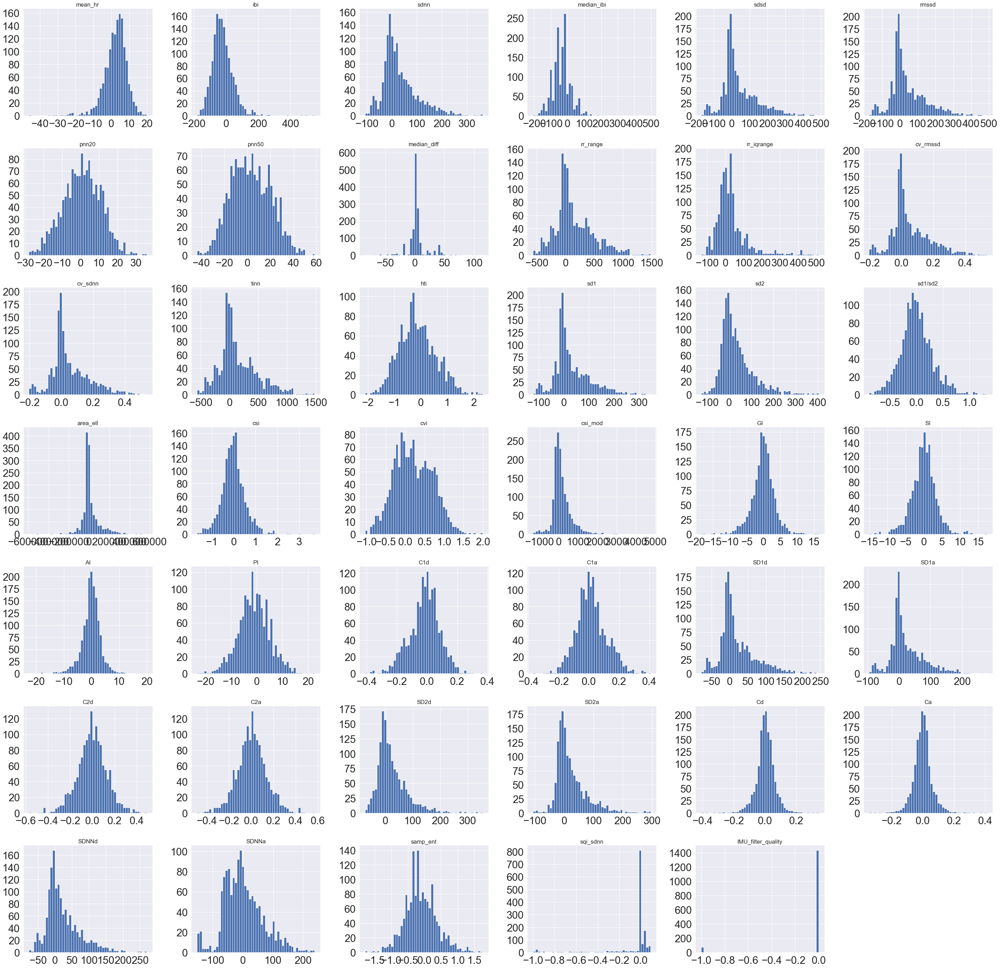

In [85]:
train_b_cl.hist(figsize=(50, 50), bins=50, xlabelsize=30, ylabelsize=30)

# 2.5. Classification Algorithms

Dummy Classifier

In [86]:
dummy_clf = DummyClassifier(strategy="uniform")
dummy_clf.fit(train_x_b, train_y_b)
DummyClassifier(strategy='uniform')
dummy_clf.predict(test_x_b) 
dummy_clf.score(test_x_b, test_y_b)


0.3167701863354037

Decision Tree Classifier

F1-score: 0.3759679002859948
Accuracy: 0.4888268156424581


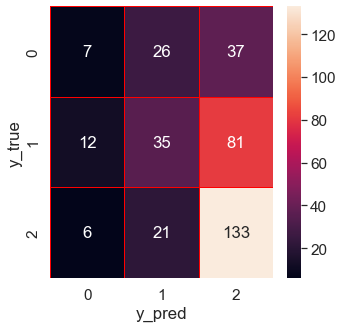

In [87]:
dt = DecisionTreeClassifier(random_state=1,max_depth=5)
dt.fit(train_x_b, train_y_b)
predictions = predict(dt, train_x_b, train_y_b, validation_x_b)
cf, fscore, accuracy = evaluate(validation_y_b, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.3158858291565519
Accuracy: 0.5062111801242236


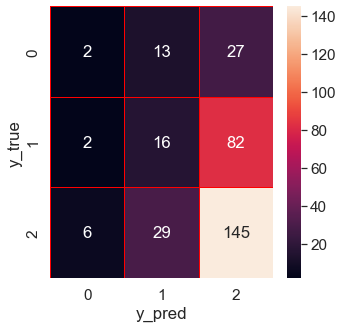

In [88]:
dt.fit(train_x_b, train_y_b)
predictions = predict(dt, train_x_b, train_y_b, test_x_b)
cf, fscore, accuracy = evaluate(test_y_b, predictions)
fscore_tree_b=fscore
acc_tree_b=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

Random Forest Classifier

F1-score: 0.3651094276094276
Accuracy: 0.44972067039106145


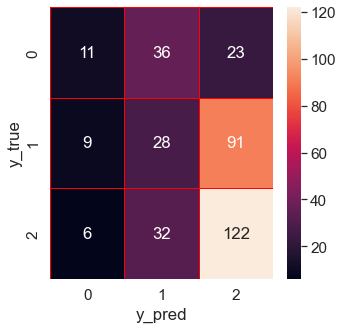

In [89]:
rf = RandomForestClassifier(random_state=2,n_estimators=100,min_samples_split=3)
predictions = predict(rf, train_x_b, train_y_b, validation_x_b)
cf, fscore, accuracy = evaluate(validation_y_b, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.32898759659718163
Accuracy: 0.4968944099378882


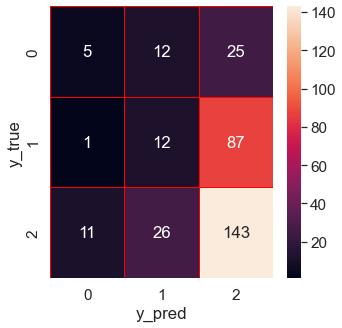

In [90]:
predictions = predict(rf, train_x_b, train_y_b, test_x_b)
cf4, fscore, accuracy = evaluate(test_y_b, predictions)
fscore_rf_b=fscore
acc_rf_b=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf4,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

In [91]:

level_encoder = LabelEncoder()
test_y_new_b = level_encoder.fit_transform(test_y_b)
validation_y_new_b = level_encoder.fit_transform(validation_y_b)
train_y_new_b = level_encoder.fit_transform(train_y_b)

XGB Classifier

F1-score: 0.3347629142471169
Accuracy: 0.41899441340782123


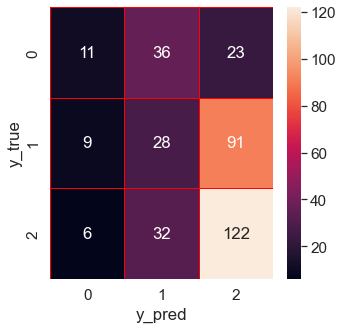

In [92]:
xg = xgb.XGBClassifier(n_estimators = 300, max_depth = 3, learning_rate=0.3, use_label_encoder=False,objective='multi:softmax',eval_metric = 'mlogloss')
predictions = predict_new(xg, train_x_b, train_y_new_b, validation_x_b)
fscore, accuracy = evaluate_new(validation_y_new_b, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.33819591711015784
Accuracy: 0.4720496894409938


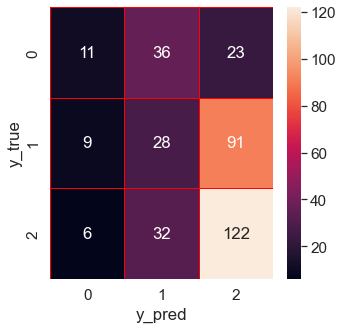

In [93]:
predictions = predict_new(xg, train_x_b, train_y_new_b, test_x_b)
fscore, accuracy = evaluate_new(test_y_new_b, predictions)
fscore_xgb_b=fscore
acc_xgb_b=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

AdaBoost Classifier

F1-score: 0.41749361749361746
Accuracy: 0.44692737430167595


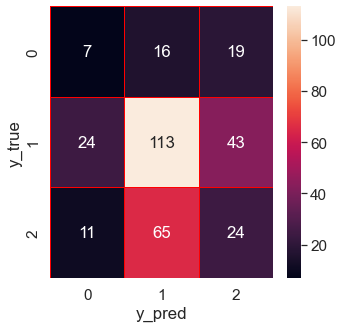

In [94]:
ada = AdaBoostClassifier(n_estimators=1300, random_state=2)
predictions = predict_new(ada, train_x_b, train_y_new_b, validation_x_b)
fscore, accuracy = evaluate_new(validation_y_new_b, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
pred2_y = ada.predict(test_x_b)
cm2=confusion_matrix(test_y_new_b,pred2_y)
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm2,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.3430030858873363
Accuracy: 0.4472049689440994


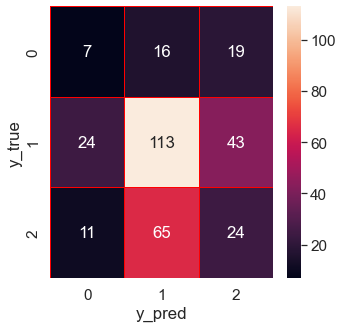

In [95]:
predictions = predict_new(ada, train_x_b, train_y_new_b, test_x_b)
fscore, accuracy = evaluate_new(test_y_new_b, predictions)
fscore_ada_b=fscore
acc_ada_b=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
pred3_y = ada.predict(test_x_b)
cm3=confusion_matrix(test_y_new_b,pred3_y)
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm3,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

Suport Vector Machine

F1-score: 0.28868153805796365
Accuracy: 0.4720670391061452


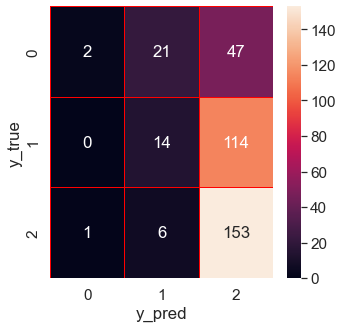

In [96]:
svc = svm.SVC( tol=0.1)
predictions = predict(svc, train_x_b, train_y_b, validation_x_b)
cf5, fscore, accuracy = evaluate(validation_y_b, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf5,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

F1-score: 0.24547050501951562
Accuracy: 0.5186335403726708


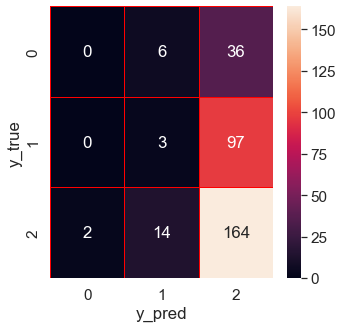

In [97]:
predictions = predict(svc, train_x_b, train_y_b, test_x_b)
cf6, fscore, accuracy = evaluate(test_y, predictions)
fscore_svc_b=fscore
acc_svc_b=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf6,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

In [98]:
data_b = {'Metric':  ['Accuracy','Fscore'],
        'RandomForest': [acc_rf_b,fscore_rf_b],
        'Decision Tree': [acc_tree_b,fscore_tree_b],
        'SVM': [acc_svc_b,fscore_svc_b],
        'AdaBoost' :[acc_ada_b,fscore_ada_b],
        'XGB':[acc_xgb_b,fscore_xgb_b],
        
        }
comparison_b = pd.DataFrame (data_b, columns = ['Metric','RandomForest','Decision Tree', 'SVM','AdaBoost','XGB'])
comparison_b

,Metric,RandomForest,Decision Tree,SVM,AdaBoost,XGB
0,Accuracy,0.496894,0.506211,0.518634,0.447205,0.472050
1,Fscore,0.328988,0.315886,0.245471,0.343003,0.338196


# 3. MinMax normalisation

# 3.1. Data Load

In [99]:
train_df_n=pd.read_csv('C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal MinMAx\\_TRAIN.CSV')
train_df_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,0.262105,0.678782,0.388164,0.666667,0.236601,0.236668,0.805648,0.546559,NaN,0.352941,...,0.410323,0.589677,0.344292,0.441956,0.639739,NaN,NaN,GroupA\01,7.0,3.0
1,0.294227,0.642921,0.341939,0.583333,0.141316,0.144228,0.694352,0.355030,NaN,0.294118,...,0.000000,1.000000,0.139452,0.422833,0.489896,NaN,NaN,GroupA\01,7.0,3.0
2,0.444887,0.483624,0.801259,0.500000,0.934135,0.934225,0.548092,0.337711,NaN,0.941176,...,0.619864,0.380136,0.827070,0.796717,0.519590,NaN,NaN,GroupA\01,7.0,3.0
3,0.635639,0.300827,0.808176,0.333333,0.879374,0.879395,0.101857,0.209790,NaN,1.000000,...,0.621294,0.378706,0.833661,0.801825,0.333012,NaN,NaN,NaN,NaN,NaN
4,0.716362,0.229107,0.907210,0.166667,1.000000,1.000000,0.052302,0.131868,NaN,1.000000,...,0.623860,0.376140,0.944605,0.906045,0.214585,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2062,0.826930,0.148598,0.406405,0.250000,0.305029,0.305074,0.393586,0.186044,0.0,0.470588,...,0.549340,0.450660,0.417727,0.393218,0.171096,1.0,NaN,GroupB\09,6.0,8.0
2063,0.585245,0.371460,0.400273,0.500000,0.301596,0.302032,0.448688,0.129708,0.0,0.470588,...,0.609757,0.390243,0.417489,0.369624,0.645318,1.0,NaN,GroupB\09,6.0,8.0
2064,0.695677,0.267291,0.339465,0.500000,0.163971,0.164037,0.367347,0.196878,0.0,0.411765,...,0.525595,0.474405,0.340523,0.329049,0.792524,1.0,NaN,GroupB\09,6.0,8.0
2065,0.613713,0.344216,0.345969,0.500000,0.200989,0.201572,0.507590,0.555891,0.0,0.411765,...,0.571512,0.428488,0.352387,0.323965,0.699231,1.0,NaN,NaN,NaN,8.0


In [100]:
validation_df_n=pd.read_csv('C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal MinMAx\\_VALIDATION.CSV')
validation_df_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,0.923255,0.054525,0.131125,0.500000,0.168649,0.168266,0.287274,0.182073,NaN,0.229167,...,0.664910,0.335090,0.134846,0.129323,0.388737,1.000000,1.0,NaN,NaN,NaN
1,0.597614,0.318401,0.485040,0.500000,0.490722,0.490484,0.358193,0.333333,NaN,0.416667,...,0.356136,0.643864,0.368224,0.583114,0.427096,0.773270,1.0,NaN,NaN,NaN
2,0.420304,0.488983,0.644540,0.500000,0.709215,0.709092,0.340720,0.464286,NaN,0.416667,...,0.436011,0.563989,0.539210,0.740551,0.084225,0.462540,1.0,NaN,NaN,NaN
3,0.521177,0.389276,0.615916,0.500000,0.554993,0.557511,0.119551,0.390977,NaN,0.416667,...,0.241070,0.758930,0.368399,0.719709,0.000000,0.518304,1.0,GroupB\07,7.0,7.0
4,0.863747,0.098646,0.198495,0.500000,0.238656,0.239230,0.246433,0.280323,NaN,0.229167,...,0.449197,0.550803,0.137174,0.197153,0.324687,1.000000,1.0,GroupB\07,7.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
484,0.114137,0.860115,0.736238,0.777778,0.676117,0.676184,0.838863,0.560327,1.00,0.782609,...,0.319780,0.680220,0.688912,0.681376,0.458769,0.586572,NaN,GroupA\04,5.0,6.0
485,0.213692,0.744577,0.361308,0.666667,0.286507,0.285944,1.000000,0.503270,1.00,0.260870,...,0.593421,0.406579,0.400956,0.335964,0.475589,1.000000,NaN,GroupA\04,5.0,6.0
486,0.248008,0.706065,0.493208,0.777778,0.409326,0.408647,0.758294,0.617384,0.50,0.391304,...,0.558069,0.441931,0.544759,0.463536,0.458769,1.000000,NaN,NaN,NaN,NaN
487,0.431405,0.510799,0.502106,0.444444,0.503270,0.502683,0.703856,0.561869,0.00,0.434783,...,0.332538,0.667462,0.509014,0.512517,0.458769,1.000000,NaN,GroupA\05,3.0,4.0


In [101]:
test_df_n=pd.read_csv('C:\\Users\\Ivona\\Desktop\\Arousal\\Arousal MinMAx\\TEST_.CSV')
test_df_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,median_diff,rr_range,...,Cd,Ca,SDNNd,SDNNa,samp_ent,sqi_sdnn,IMU_filter_quality,video,arousal,valence
0,0.816011,0.158758,0.077589,0.000000,0.057361,0.057136,0.482500,0.263301,1.0,0.000000,...,0.737393,0.262607,0.089511,0.065336,0.408345,1.000000,NaN,GroupD\16,5.0,2.0
1,0.707879,0.256727,0.204078,0.333333,0.063402,0.063583,0.551282,0.110283,1.0,0.052632,...,0.854244,0.145756,0.225645,0.168512,0.504864,1.000000,NaN,NaN,NaN,NaN
2,0.658645,0.302545,0.207092,0.333333,0.058352,0.058116,0.551282,0.055142,1.0,0.052632,...,0.762847,0.237153,0.221010,0.187064,0.259866,1.000000,NaN,NaN,NaN,NaN
3,0.691375,0.272000,0.153564,0.333333,0.000000,0.000000,0.171795,0.000000,1.0,0.052632,...,0.725145,0.274855,0.155427,0.132405,0.272362,1.000000,NaN,GroupD\17,7.0,2.0
4,0.828600,0.147583,0.025847,0.000000,0.039929,0.039884,0.112500,0.263301,1.0,0.000000,...,0.651107,0.348893,0.026953,0.018907,0.307698,1.000000,NaN,GroupD\17,7.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,0.575357,0.366998,0.187172,0.347826,0.220627,0.220725,0.654342,0.561901,0.5,0.321429,...,0.669347,0.330653,0.189531,0.187672,0.575917,1.000000,NaN,GroupD\20,2.0,1.0
480,0.574090,0.368203,0.025746,0.521739,0.003042,0.003047,0.370231,0.192410,0.5,0.035714,...,0.663678,0.336322,0.026627,0.029850,0.721057,1.000000,NaN,GroupD\20,2.0,1.0
481,0.438840,0.501124,0.000000,0.521739,0.007624,0.007626,0.392479,0.175320,0.5,0.035714,...,0.739065,0.260935,0.008834,0.000000,0.557886,1.000000,NaN,GroupD\20,2.0,1.0
482,0.371573,0.570551,0.472228,0.521739,0.233958,0.235527,0.495315,0.230007,0.5,0.607143,...,0.384871,0.615129,0.361402,0.496446,0.605285,0.879816,NaN,GroupD\20,2.0,1.0


In [102]:
del train_df_n['video']
del train_df_n['valence']
del train_df_n['median_diff']
del train_df_n['sqi_sdnn']
del train_df_n['IMU_filter_quality']
train_df_n.dropna(axis=0, inplace=True, subset=['arousal'])
train_df_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,arousal
0,0.262105,0.678782,0.388164,0.666667,0.236601,0.236668,0.805648,0.546559,0.352941,0.300000,...,0.337479,0.662521,0.361851,0.490049,0.410323,0.589677,0.344292,0.441956,0.639739,7.0
1,0.294227,0.642921,0.341939,0.583333,0.141316,0.144228,0.694352,0.355030,0.294118,0.200000,...,0.000000,1.000000,0.169493,0.471640,0.000000,1.000000,0.139452,0.422833,0.489896,7.0
2,0.444887,0.483624,0.801259,0.500000,0.934135,0.934225,0.548092,0.337711,0.941176,0.200000,...,0.616655,0.383345,0.651497,0.599757,0.619864,0.380136,0.827070,0.796717,0.519590,7.0
8,0.357932,0.573825,0.254169,0.666667,0.092897,0.093255,0.588621,0.288462,0.176471,0.200000,...,0.662763,0.337237,0.326744,0.273094,0.688449,0.311551,0.268702,0.231606,0.408080,8.0
9,0.395931,0.533842,0.108389,0.500000,0.050763,0.050868,0.465532,0.115385,0.117647,0.200000,...,0.611097,0.388903,0.152229,0.131938,0.613437,0.386563,0.114625,0.112847,0.327544,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,0.358426,0.598829,0.127251,0.750000,0.022262,0.023167,0.236152,0.251048,0.117647,0.000000,...,0.545478,0.454522,0.236373,0.211492,0.841427,0.158573,0.150400,0.076663,0.187953,2.0
2059,0.270713,0.691980,0.058334,0.750000,0.023789,0.023789,0.286006,0.129708,0.058824,0.333333,...,0.461037,0.538963,0.120438,0.140023,0.614689,0.385311,0.060821,0.045623,0.157450,2.0
2062,0.826930,0.148598,0.406405,0.250000,0.305029,0.305074,0.393586,0.186044,0.470588,0.416667,...,0.328892,0.671108,0.445836,0.579022,0.549340,0.450660,0.417727,0.393218,0.171096,6.0
2063,0.585245,0.371460,0.400273,0.500000,0.301596,0.302032,0.448688,0.129708,0.470588,0.333333,...,0.353127,0.646873,0.438346,0.548650,0.609757,0.390243,0.417489,0.369624,0.645318,6.0


In [103]:
del validation_df_n['video']
del validation_df_n['valence']
del validation_df_n['median_diff']
del validation_df_n['sqi_sdnn']
del validation_df_n['IMU_filter_quality']
validation_df_n.dropna(axis=0, inplace=True, subset=['arousal'])
validation_df_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,arousal
3,0.521177,0.389276,0.615916,0.500000,0.554993,0.557511,0.119551,0.390977,0.416667,0.190476,...,0.124677,0.875323,0.287816,0.749996,0.241070,0.758930,0.368399,0.719709,0.000000,7.0
4,0.863747,0.098646,0.198495,0.500000,0.238656,0.239230,0.246433,0.280323,0.229167,0.190476,...,0.418623,0.581377,0.107240,0.158571,0.449197,0.550803,0.137174,0.197153,0.324687,7.0
5,0.947922,0.036716,0.030414,0.500000,0.015380,0.015007,0.134223,0.101299,0.041667,0.190476,...,0.609848,0.390152,0.042588,0.041054,0.646867,0.353133,0.031734,0.029664,0.278507,7.0
8,0.655875,0.266870,0.399807,0.500000,0.460981,0.461128,0.938215,0.645963,0.270833,0.380952,...,0.643700,0.356300,0.357981,0.336713,0.678426,0.321574,0.396374,0.379841,0.598909,9.0
9,0.642675,0.278364,0.286514,0.500000,0.335177,0.335025,0.671564,0.524845,0.250000,0.380952,...,0.400138,0.599862,0.208687,0.303474,0.556228,0.443772,0.263397,0.305338,0.502173,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,0.538504,0.404382,0.639079,0.444444,0.741983,0.741700,0.758294,0.560327,0.913043,0.208333,...,0.764213,0.235787,0.622994,0.305327,0.472403,0.527597,0.697768,0.623524,0.458769,5.0
484,0.114137,0.860115,0.736238,0.777778,0.676117,0.676184,0.838863,0.560327,0.782609,0.666667,...,0.543676,0.456324,0.706254,0.513729,0.319780,0.680220,0.688912,0.681376,0.458769,5.0
485,0.213692,0.744577,0.361308,0.666667,0.286507,0.285944,1.000000,0.503270,0.260870,0.375000,...,0.533884,0.466116,0.474505,0.347312,0.593421,0.406579,0.400956,0.335964,0.475589,5.0
487,0.431405,0.510799,0.502106,0.444444,0.503270,0.502683,0.703856,0.561869,0.434783,0.625000,...,0.183820,0.816180,0.392707,0.512718,0.332538,0.667462,0.509014,0.512517,0.458769,3.0


In [104]:
del test_df_n['video']
del test_df_n['valence']
del test_df_n['median_diff']
del test_df_n['sqi_sdnn']
del test_df_n['IMU_filter_quality']
test_df_n.dropna(axis=0, inplace=True, subset=['arousal'])
test_df_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,arousal
0,0.816011,0.158758,0.077589,0.000000,0.057361,0.057136,0.482500,0.263301,0.000000,0.333333,...,0.587778,0.412222,0.196683,0.083102,0.737393,0.262607,0.089511,0.065336,0.408345,5.0
3,0.691375,0.272000,0.153564,0.333333,0.000000,0.000000,0.171795,0.000000,0.052632,0.333333,...,0.481313,0.518687,0.326899,0.230038,0.725145,0.274855,0.155427,0.132405,0.272362,7.0
4,0.828600,0.147583,0.025847,0.000000,0.039929,0.039884,0.112500,0.263301,0.000000,0.000000,...,0.440326,0.559674,0.085944,0.028638,0.651107,0.348893,0.026953,0.018907,0.307698,7.0
5,1.000000,0.000000,0.077569,0.000000,0.103918,0.103833,0.056098,0.408855,0.052632,0.333333,...,0.370602,0.629398,0.113037,0.072716,0.566704,0.433296,0.068291,0.077597,0.460918,7.0
8,0.490116,0.465455,0.075140,0.333333,0.040272,0.040087,0.136842,0.345360,0.105263,0.000000,...,0.298337,0.701663,0.154170,0.134759,0.545436,0.454564,0.068413,0.082041,0.321949,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,0.575357,0.366998,0.187172,0.347826,0.220627,0.220725,0.654342,0.561901,0.321429,0.218750,...,0.690858,0.309142,0.141859,0.083904,0.669347,0.330653,0.189531,0.187672,0.575917,2.0
480,0.574090,0.368203,0.025746,0.521739,0.003042,0.003047,0.370231,0.192410,0.035714,0.125000,...,0.474476,0.525524,0.043351,0.064821,0.663678,0.336322,0.026627,0.029850,0.721057,2.0
481,0.438840,0.501124,0.000000,0.521739,0.007624,0.007626,0.392479,0.175320,0.035714,0.125000,...,0.566050,0.433950,0.018594,0.016926,0.739065,0.260935,0.008834,0.000000,0.557886,2.0
482,0.371573,0.570551,0.472228,0.521739,0.233958,0.235527,0.495315,0.230007,0.607143,0.187500,...,0.000000,1.000000,0.269438,0.662783,0.384871,0.615129,0.361402,0.496446,0.605285,2.0


In [105]:
train_n_cl=train_df_n.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
train_n_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,arousal
0,0.262105,0.678782,0.388164,0.666667,0.236601,0.236668,0.805648,0.546559,0.352941,0.300000,...,0.337479,0.662521,0.361851,0.490049,0.410323,0.589677,0.344292,0.441956,0.639739,high
1,0.294227,0.642921,0.341939,0.583333,0.141316,0.144228,0.694352,0.355030,0.294118,0.200000,...,0.000000,1.000000,0.169493,0.471640,0.000000,1.000000,0.139452,0.422833,0.489896,high
2,0.444887,0.483624,0.801259,0.500000,0.934135,0.934225,0.548092,0.337711,0.941176,0.200000,...,0.616655,0.383345,0.651497,0.599757,0.619864,0.380136,0.827070,0.796717,0.519590,high
8,0.357932,0.573825,0.254169,0.666667,0.092897,0.093255,0.588621,0.288462,0.176471,0.200000,...,0.662763,0.337237,0.326744,0.273094,0.688449,0.311551,0.268702,0.231606,0.408080,high
9,0.395931,0.533842,0.108389,0.500000,0.050763,0.050868,0.465532,0.115385,0.117647,0.200000,...,0.611097,0.388903,0.152229,0.131938,0.613437,0.386563,0.114625,0.112847,0.327544,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,0.358426,0.598829,0.127251,0.750000,0.022262,0.023167,0.236152,0.251048,0.117647,0.000000,...,0.545478,0.454522,0.236373,0.211492,0.841427,0.158573,0.150400,0.076663,0.187953,low
2059,0.270713,0.691980,0.058334,0.750000,0.023789,0.023789,0.286006,0.129708,0.058824,0.333333,...,0.461037,0.538963,0.120438,0.140023,0.614689,0.385311,0.060821,0.045623,0.157450,low
2062,0.826930,0.148598,0.406405,0.250000,0.305029,0.305074,0.393586,0.186044,0.470588,0.416667,...,0.328892,0.671108,0.445836,0.579022,0.549340,0.450660,0.417727,0.393218,0.171096,medium
2063,0.585245,0.371460,0.400273,0.500000,0.301596,0.302032,0.448688,0.129708,0.470588,0.333333,...,0.353127,0.646873,0.438346,0.548650,0.609757,0.390243,0.417489,0.369624,0.645318,medium


In [106]:
validation_n_cl=validation_df_n.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
validation_n_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,arousal
3,0.521177,0.389276,0.615916,0.500000,0.554993,0.557511,0.119551,0.390977,0.416667,0.190476,...,0.124677,0.875323,0.287816,0.749996,0.241070,0.758930,0.368399,0.719709,0.000000,high
4,0.863747,0.098646,0.198495,0.500000,0.238656,0.239230,0.246433,0.280323,0.229167,0.190476,...,0.418623,0.581377,0.107240,0.158571,0.449197,0.550803,0.137174,0.197153,0.324687,high
5,0.947922,0.036716,0.030414,0.500000,0.015380,0.015007,0.134223,0.101299,0.041667,0.190476,...,0.609848,0.390152,0.042588,0.041054,0.646867,0.353133,0.031734,0.029664,0.278507,high
8,0.655875,0.266870,0.399807,0.500000,0.460981,0.461128,0.938215,0.645963,0.270833,0.380952,...,0.643700,0.356300,0.357981,0.336713,0.678426,0.321574,0.396374,0.379841,0.598909,high
9,0.642675,0.278364,0.286514,0.500000,0.335177,0.335025,0.671564,0.524845,0.250000,0.380952,...,0.400138,0.599862,0.208687,0.303474,0.556228,0.443772,0.263397,0.305338,0.502173,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,0.538504,0.404382,0.639079,0.444444,0.741983,0.741700,0.758294,0.560327,0.913043,0.208333,...,0.764213,0.235787,0.622994,0.305327,0.472403,0.527597,0.697768,0.623524,0.458769,medium
484,0.114137,0.860115,0.736238,0.777778,0.676117,0.676184,0.838863,0.560327,0.782609,0.666667,...,0.543676,0.456324,0.706254,0.513729,0.319780,0.680220,0.688912,0.681376,0.458769,medium
485,0.213692,0.744577,0.361308,0.666667,0.286507,0.285944,1.000000,0.503270,0.260870,0.375000,...,0.533884,0.466116,0.474505,0.347312,0.593421,0.406579,0.400956,0.335964,0.475589,medium
487,0.431405,0.510799,0.502106,0.444444,0.503270,0.502683,0.703856,0.561869,0.434783,0.625000,...,0.183820,0.816180,0.392707,0.512718,0.332538,0.667462,0.509014,0.512517,0.458769,low


In [107]:
test_n_cl=test_df_n.replace({'arousal': {1.0:'low',2.0:'low',3.0:'low',4.0:'medium',5.0:'medium',6.0:'medium',7.0: 'high', 8.0: 'high',9.0:'high'}})
test_n_cl

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent,arousal
0,0.816011,0.158758,0.077589,0.000000,0.057361,0.057136,0.482500,0.263301,0.000000,0.333333,...,0.587778,0.412222,0.196683,0.083102,0.737393,0.262607,0.089511,0.065336,0.408345,medium
3,0.691375,0.272000,0.153564,0.333333,0.000000,0.000000,0.171795,0.000000,0.052632,0.333333,...,0.481313,0.518687,0.326899,0.230038,0.725145,0.274855,0.155427,0.132405,0.272362,high
4,0.828600,0.147583,0.025847,0.000000,0.039929,0.039884,0.112500,0.263301,0.000000,0.000000,...,0.440326,0.559674,0.085944,0.028638,0.651107,0.348893,0.026953,0.018907,0.307698,high
5,1.000000,0.000000,0.077569,0.000000,0.103918,0.103833,0.056098,0.408855,0.052632,0.333333,...,0.370602,0.629398,0.113037,0.072716,0.566704,0.433296,0.068291,0.077597,0.460918,high
8,0.490116,0.465455,0.075140,0.333333,0.040272,0.040087,0.136842,0.345360,0.105263,0.000000,...,0.298337,0.701663,0.154170,0.134759,0.545436,0.454564,0.068413,0.082041,0.321949,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,0.575357,0.366998,0.187172,0.347826,0.220627,0.220725,0.654342,0.561901,0.321429,0.218750,...,0.690858,0.309142,0.141859,0.083904,0.669347,0.330653,0.189531,0.187672,0.575917,low
480,0.574090,0.368203,0.025746,0.521739,0.003042,0.003047,0.370231,0.192410,0.035714,0.125000,...,0.474476,0.525524,0.043351,0.064821,0.663678,0.336322,0.026627,0.029850,0.721057,low
481,0.438840,0.501124,0.000000,0.521739,0.007624,0.007626,0.392479,0.175320,0.035714,0.125000,...,0.566050,0.433950,0.018594,0.016926,0.739065,0.260935,0.008834,0.000000,0.557886,low
482,0.371573,0.570551,0.472228,0.521739,0.233958,0.235527,0.495315,0.230007,0.607143,0.187500,...,0.000000,1.000000,0.269438,0.662783,0.384871,0.615129,0.361402,0.496446,0.605285,low


In [176]:
train_x_n=train_n_cl.drop(['arousal'], axis=1)
train_x_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,SD1a,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent
0,0.262105,0.678782,0.388164,0.666667,0.236601,0.236668,0.805648,0.546559,0.352941,0.300000,...,0.223053,0.337479,0.662521,0.361851,0.490049,0.410323,0.589677,0.344292,0.441956,0.639739
1,0.294227,0.642921,0.341939,0.583333,0.141316,0.144228,0.694352,0.355030,0.294118,0.200000,...,0.206932,0.000000,1.000000,0.169493,0.471640,0.000000,1.000000,0.139452,0.422833,0.489896
2,0.444887,0.483624,0.801259,0.500000,0.934135,0.934225,0.548092,0.337711,0.941176,0.200000,...,0.938110,0.616655,0.383345,0.651497,0.599757,0.619864,0.380136,0.827070,0.796717,0.519590
8,0.357932,0.573825,0.254169,0.666667,0.092897,0.093255,0.588621,0.288462,0.176471,0.200000,...,0.090315,0.662763,0.337237,0.326744,0.273094,0.688449,0.311551,0.268702,0.231606,0.408080
9,0.395931,0.533842,0.108389,0.500000,0.050763,0.050868,0.465532,0.115385,0.117647,0.200000,...,0.067106,0.611097,0.388903,0.152229,0.131938,0.613437,0.386563,0.114625,0.112847,0.327544
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058,0.358426,0.598829,0.127251,0.750000,0.022262,0.023167,0.236152,0.251048,0.117647,0.000000,...,0.011408,0.545478,0.454522,0.236373,0.211492,0.841427,0.158573,0.150400,0.076663,0.187953
2059,0.270713,0.691980,0.058334,0.750000,0.023789,0.023789,0.286006,0.129708,0.058824,0.333333,...,0.030814,0.461037,0.538963,0.120438,0.140023,0.614689,0.385311,0.060821,0.045623,0.157450
2062,0.826930,0.148598,0.406405,0.250000,0.305029,0.305074,0.393586,0.186044,0.470588,0.416667,...,0.241372,0.328892,0.671108,0.445836,0.579022,0.549340,0.450660,0.417727,0.393218,0.171096
2063,0.585245,0.371460,0.400273,0.500000,0.301596,0.302032,0.448688,0.129708,0.470588,0.333333,...,0.227766,0.353127,0.646873,0.438346,0.548650,0.609757,0.390243,0.417489,0.369624,0.645318


In [109]:
validation_x_n=validation_n_cl.drop(['arousal'], axis=1)
validation_x_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,SD1a,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent
3,0.521177,0.389276,0.615916,0.500000,0.554993,0.557511,0.119551,0.390977,0.416667,0.190476,...,0.548818,0.124677,0.875323,0.287816,0.749996,0.241070,0.758930,0.368399,0.719709,0.000000
4,0.863747,0.098646,0.198495,0.500000,0.238656,0.239230,0.246433,0.280323,0.229167,0.190476,...,0.249462,0.418623,0.581377,0.107240,0.158571,0.449197,0.550803,0.137174,0.197153,0.324687
5,0.947922,0.036716,0.030414,0.500000,0.015380,0.015007,0.134223,0.101299,0.041667,0.190476,...,0.015659,0.609848,0.390152,0.042588,0.041054,0.646867,0.353133,0.031734,0.029664,0.278507
8,0.655875,0.266870,0.399807,0.500000,0.460981,0.461128,0.938215,0.645963,0.270833,0.380952,...,0.420930,0.643700,0.356300,0.357981,0.336713,0.678426,0.321574,0.396374,0.379841,0.598909
9,0.642675,0.278364,0.286514,0.500000,0.335177,0.335025,0.671564,0.524845,0.250000,0.380952,...,0.278755,0.400138,0.599862,0.208687,0.303474,0.556228,0.443772,0.263397,0.305338,0.502173
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,0.538504,0.404382,0.639079,0.444444,0.741983,0.741700,0.758294,0.560327,0.913043,0.208333,...,0.758249,0.764213,0.235787,0.622994,0.305327,0.472403,0.527597,0.697768,0.623524,0.458769
484,0.114137,0.860115,0.736238,0.777778,0.676117,0.676184,0.838863,0.560327,0.782609,0.666667,...,0.714692,0.543676,0.456324,0.706254,0.513729,0.319780,0.680220,0.688912,0.681376,0.458769
485,0.213692,0.744577,0.361308,0.666667,0.286507,0.285944,1.000000,0.503270,0.260870,0.375000,...,0.271271,0.533884,0.466116,0.474505,0.347312,0.593421,0.406579,0.400956,0.335964,0.475589
487,0.431405,0.510799,0.502106,0.444444,0.503270,0.502683,0.703856,0.561869,0.434783,0.625000,...,0.428634,0.183820,0.816180,0.392707,0.512718,0.332538,0.667462,0.509014,0.512517,0.458769


In [110]:
test_x_n=test_n_cl.drop(['arousal'], axis=1)
test_x_n

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,SD1a,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent
0,0.816011,0.158758,0.077589,0.000000,0.057361,0.057136,0.482500,0.263301,0.000000,0.333333,...,0.091417,0.587778,0.412222,0.196683,0.083102,0.737393,0.262607,0.089511,0.065336,0.408345
3,0.691375,0.272000,0.153564,0.333333,0.000000,0.000000,0.171795,0.000000,0.052632,0.333333,...,0.000000,0.481313,0.518687,0.326899,0.230038,0.725145,0.274855,0.155427,0.132405,0.272362
4,0.828600,0.147583,0.025847,0.000000,0.039929,0.039884,0.112500,0.263301,0.000000,0.000000,...,0.059011,0.440326,0.559674,0.085944,0.028638,0.651107,0.348893,0.026953,0.018907,0.307698
5,1.000000,0.000000,0.077569,0.000000,0.103918,0.103833,0.056098,0.408855,0.052632,0.333333,...,0.134342,0.370602,0.629398,0.113037,0.072716,0.566704,0.433296,0.068291,0.077597,0.460918
8,0.490116,0.465455,0.075140,0.333333,0.040272,0.040087,0.136842,0.345360,0.105263,0.000000,...,0.048181,0.298337,0.701663,0.154170,0.134759,0.545436,0.454564,0.068413,0.082041,0.321949
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,0.575357,0.366998,0.187172,0.347826,0.220627,0.220725,0.654342,0.561901,0.321429,0.218750,...,0.251667,0.690858,0.309142,0.141859,0.083904,0.669347,0.330653,0.189531,0.187672,0.575917
480,0.574090,0.368203,0.025746,0.521739,0.003042,0.003047,0.370231,0.192410,0.035714,0.125000,...,0.024079,0.474476,0.525524,0.043351,0.064821,0.663678,0.336322,0.026627,0.029850,0.721057
481,0.438840,0.501124,0.000000,0.521739,0.007624,0.007626,0.392479,0.175320,0.035714,0.125000,...,0.029887,0.566050,0.433950,0.018594,0.016926,0.739065,0.260935,0.008834,0.000000,0.557886
482,0.371573,0.570551,0.472228,0.521739,0.233958,0.235527,0.495315,0.230007,0.607143,0.187500,...,0.074874,0.000000,1.000000,0.269438,0.662783,0.384871,0.615129,0.361402,0.496446,0.605285


In [111]:
train_x_n.describe()

,mean_hr,ibi,sdnn,median_ibi,sdsd,rmssd,pnn20,pnn50,rr_range,rr_iqrange,...,SD1a,C2d,C2a,SD2d,SD2a,Cd,Ca,SDNNd,SDNNa,samp_ent
count,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,...,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000,1509.000000
mean,0.520056,0.416727,0.291238,0.457836,0.244549,0.244716,0.524052,0.440358,0.282289,0.261035,...,0.243097,0.472403,0.527597,0.276851,0.289836,0.531706,0.468294,0.279986,0.283182,0.421723
std,0.234635,0.239849,0.235209,0.251057,0.227391,0.227373,0.223425,0.223823,0.231937,0.210187,...,0.229820,0.200349,0.200349,0.223051,0.223084,0.188459,0.188459,0.228505,0.228061,0.200385
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.343096,0.226022,0.106308,0.300000,0.067974,0.067416,0.375510,0.271647,0.105263,0.093750,...,0.062613,0.340038,0.399407,0.100991,0.110983,0.400083,0.338967,0.102515,0.100420,0.290318
50%,0.536565,0.381563,0.228716,0.444444,0.165328,0.165273,0.529412,0.421154,0.214286,0.200000,...,0.159086,0.469492,0.530508,0.217238,0.240199,0.533110,0.466890,0.220281,0.230846,0.412994
75%,0.699553,0.591693,0.425914,0.666667,0.372821,0.372869,0.676748,0.596850,0.411765,0.363636,...,0.367721,0.600593,0.659962,0.389735,0.420622,0.661033,0.599917,0.407041,0.416793,0.533668
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [112]:
train_y_n=train_n_cl["arousal"]
train_y_n

0         high
1         high
2         high
8         high
9         high
         ...  
2058       low
2059       low
2062    medium
2063    medium
2064    medium
Name: arousal, Length: 1509, dtype: object

In [113]:
validation_y_n=validation_n_cl["arousal"]
validation_y_n

3        high
4        high
5        high
8        high
9        high
        ...  
483    medium
484    medium
485    medium
487       low
488       low
Name: arousal, Length: 358, dtype: object

In [114]:
test_y_n=test_n_cl["arousal"]
test_y_n

0      medium
3        high
4        high
5        high
8         low
        ...  
479       low
480       low
481       low
482       low
483       low
Name: arousal, Length: 322, dtype: object

# 3.2. Correlation Matrix

In [115]:
sns.set(font_scale=6.5)
correlation=train_n_cl.corr()
plt.figure(figsize=(250,130))
sns.heatmap(correlation, annot=True, fmt='.3f')
plt.show()

# 3.3. Data Visualisation

(array([0, 1, 2]),
 [Text(0, 0, 'high'), Text(1, 0, 'medium'), Text(2, 0, 'low')])

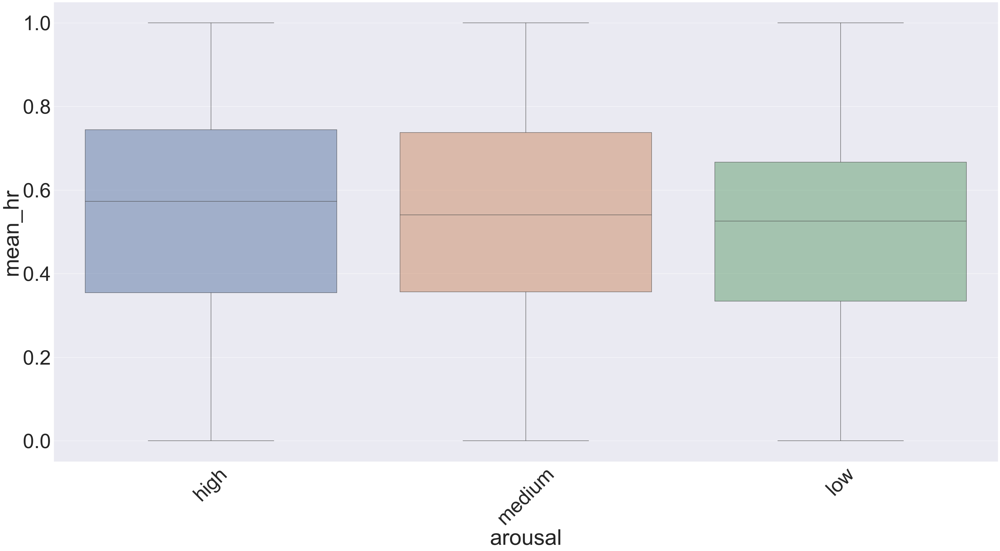

In [116]:
plt.figure(figsize = (60, 30))
ax = sns.boxplot(x='arousal', y='mean_hr', data=train_n_cl)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

<AxesSubplot:xlabel='AI', ylabel='GI'>

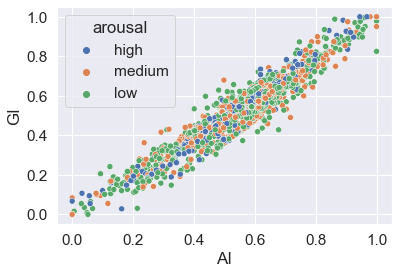

In [117]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['AI'], y=train_n_cl['GI'], hue=train_n_cl['arousal'])

<AxesSubplot:xlabel='mean_hr', ylabel='ibi'>

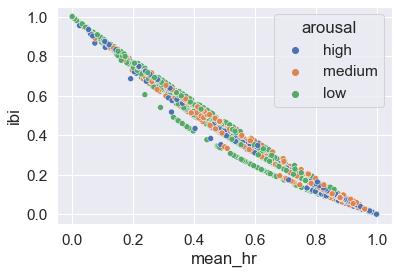

In [118]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['mean_hr'], y=train_n_cl['ibi'], hue=train_n_cl['arousal'])

<AxesSubplot:xlabel='hti', ylabel='samp_ent'>

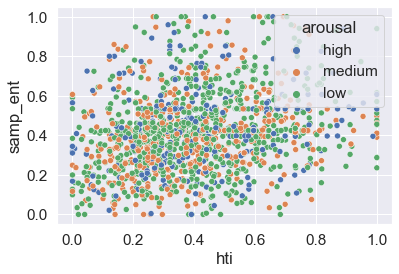

In [119]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['hti'], y=train_n_cl['samp_ent'], hue=train_n_cl['arousal'])

<AxesSubplot:xlabel='sdnn', ylabel='SDNNa'>

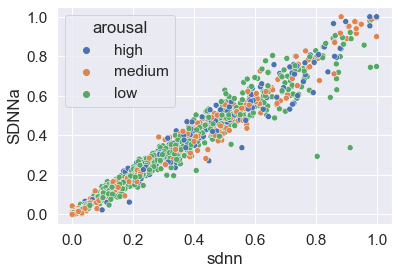

In [120]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['sdnn'], y=train_n_cl['SDNNa'], hue=train_n_cl['arousal'])

<AxesSubplot:xlabel='pnn20', ylabel='pnn50'>

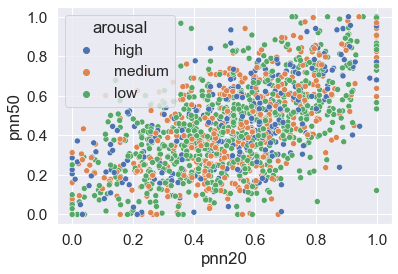

In [121]:

sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['pnn20'], y=train_n_cl['pnn50'], hue=train_n_cl['arousal'])

<AxesSubplot:xlabel='cvi', ylabel='sdnn'>

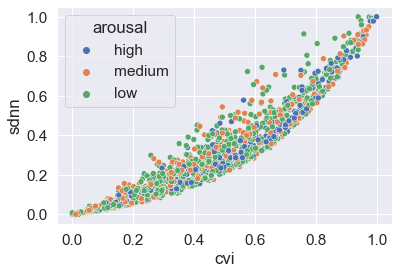

In [122]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['cvi'], y=train_n_cl['sdnn'], hue=train_n_cl['arousal'])

<AxesSubplot:xlabel='sdnn', ylabel='median_ibi'>

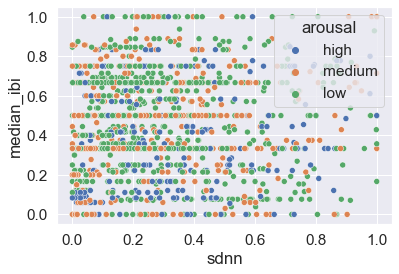

In [123]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['sdnn'], 
y=train_n_cl['median_ibi'], hue=train_n_cl['arousal'])

<AxesSubplot:xlabel='sd1', ylabel='SD1d'>

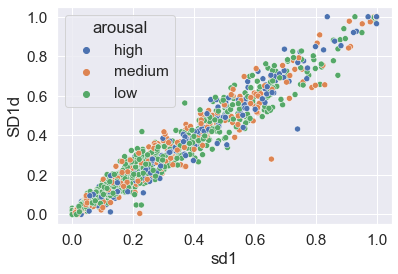

In [124]:
sns.set(font_scale=1.4)
sns.scatterplot(x=train_n_cl['sd1'], y=train_n_cl['SD1d'], hue=train_n_cl['arousal'])

# 3.4. Classification Algorithms

Decision Tree

In [125]:
clf = DecisionTreeClassifier(random_state=2,max_depth=15,max_features="log2")
predictions = predict(clf, train_x_n, train_y_n, validation_x_n)
cf, fscore, accuracy = evaluate(validation_y_n, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.3114326346713268
Accuracy: 0.3435754189944134


In [126]:
predictions = predict(clf, train_x_n, train_y_n, test_x_n)
cf, fscore, accuracy = evaluate(test_y_n, predictions)
fscore_tree_n=fscore
acc_tree_n=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.32782820016862574
Accuracy: 0.4192546583850932


Suport Vector Machine

In [127]:
clf = SVC(kernel='poly',tol=0.1,degree=5)
predictions = predict(clf, train_x_n, train_y_n, validation_x_n)
cf, fscore, accuracy = evaluate(validation_y_n, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")


F1-score: 0.4195247009070979
Accuracy: 0.43575418994413406


In [128]:
predictions = predict(clf, train_x_n, train_y_n, test_x_n)
cf, fscore, accuracy = evaluate(test_y_n, predictions)
fscore_svm_n=fscore
acc_svm_n=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.2808593159031207
Accuracy: 0.3695652173913043


KNN

In [129]:
clf=KNeighborsClassifier(n_neighbors=3,weights='distance')
predictions = predict(clf, train_x_n, train_y_n, validation_x_n)
cf, fscore, accuracy = evaluate(validation_y_n, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.2547865334607959
Accuracy: 0.28212290502793297


In [130]:
predictions = predict(clf, train_x_n, train_y, test_x_n)
cf, fscore, accuracy = evaluate(test_y_n, predictions)
fscore_knn_n=fscore
acc_knn_n=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.29604395604395606
Accuracy: 0.37888198757763975


Random Forest

In [131]:
clf = RandomForestClassifier(random_state=1,n_estimators=350,min_samples_split=2,max_depth=25,max_features="sqrt")
predictions = predict(clf, train_x_n, train_y_n, validation_x_n)
cf, fscore, accuracy = evaluate(validation_y_n, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.3445280615451658
Accuracy: 0.40782122905027934


In [132]:
predictions = predict(clf, train_x_n, train_y_n, test_x_n)
cf, fscore, accuracy = evaluate(test_y_n, predictions)
fscore_forest_n=fscore
acc_forest_n=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.29658353213330446
Accuracy: 0.4503105590062112


In [177]:
level_encoder = LabelEncoder()
test_y_new_n = level_encoder.fit_transform(test_y_n)
validation_y_new_n = level_encoder.fit_transform(validation_y_n)
train_y_new_n = level_encoder.fit_transform(train_y_n)

XGB

In [134]:
clf = xgb.XGBClassifier(n_estimators = 400, max_depth = 5, learning_rate=0.3, use_label_encoder=False,objective='multi:softmax',eval_metric = 'mlogloss')
predictions = predict_new(clf, train_x_n, train_y_new_n, validation_x_n)
fscore, accuracy = evaluate_new(validation_y_new_n, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")


F1-score: 0.35616426457126443
Accuracy: 0.4134078212290503


In [135]:
predictions = predict_new(clf, train_x_n, train_y_new_n, test_x_n)
fscore, accuracy = evaluate_new(test_y_new_n, predictions)
fscore_xgb_n=fscore
acc_xgb_n=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")

F1-score: 0.33130615000475494
Accuracy: 0.45652173913043476


AdaBoost

In [136]:
clf = AdaBoostClassifier(n_estimators=150, random_state=3)
predictions = predict_new(clf, train_x_n, train_y_new_n, validation_x_n)
fscore, accuracy = evaluate_new(validation_y_new_n, predictions)
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")


F1-score: 0.3383158103375976
Accuracy: 0.40502793296089384


In [137]:
predictions = predict_new(clf, train_x_n, train_y_new_n, test_x_n)
fscore, accuracy = evaluate_new(test_y_new_n, predictions)
fscore_ada_n=fscore
acc_ada_n=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")


F1-score: 0.3582593781595504
Accuracy: 0.45962732919254656


In [138]:
data_n = {'Metric':  ['Accuracy','Fscore'],
        'RandomForest': [acc_forest_n,fscore_forest_n],
        'Decision Tree': [acc_tree_n,fscore_tree_n],
        'KNN':[acc_knn_n,fscore_knn_n],
        'SVM': [acc_svm_n,fscore_svm_n],
        'AdaBoost' :[acc_ada_n,fscore_ada_n],
        'XGB':[acc_xgb_n,fscore_xgb_n],
        
        }
comparison_n = pd.DataFrame (data_n, columns = ['Metric','RandomForest','Decision Tree','KNN' ,'SVM','AdaBoost','XGB'])
comparison_n

,Metric,RandomForest,Decision Tree,KNN,SVM,AdaBoost,XGB
0,Accuracy,0.450311,0.419255,0.378882,0.369565,0.459627,0.456522
1,Fscore,0.296584,0.327828,0.296044,0.280859,0.358259,0.331306


# 4. Best Models for Classification

Baseline: Desicion Tree

MinMax: AdaBoost


In [139]:
#!pip install imblearn

In [140]:

# Undersample and plot imbalanced dataset with the Condensed Nearest Neighbor Rule
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.under_sampling import CondensedNearestNeighbour
from matplotlib import pyplot
from numpy import where



Baseline undersampling

In [141]:
counter = Counter(train_y_b)
print(counter)
# define the undersampling method
undersample = CondensedNearestNeighbour(n_neighbors=1)
# transform the dataset
train_x_under, train_y_under = undersample.fit_resample(train_x_b, train_y_b)
# summarize the new class distribution
counter = Counter(train_y_under)
print(counter)


Counter({'low': 778, 'medium': 456, 'high': 275})
Counter({'low': 303, 'high': 275, 'medium': 214})


Normalisation undersmpling

In [168]:
counter = Counter(train_y_n)
print(counter)
# define the undersampling method
undersample = CondensedNearestNeighbour(n_neighbors=1)
# transform the dataset
train_x_under_n, train_y_under_n = undersample.fit_resample(train_x_n, train_y_n)
# summarize the new class distribution
counter = Counter(train_y_under_n)
print(counter)

Counter({'low': 778, 'medium': 456, 'high': 275})
Counter({'high': 275, 'low': 272, 'medium': 201})


Decision Tree

F1-score: 0.3604159193195898
Accuracy: 0.4503105590062112


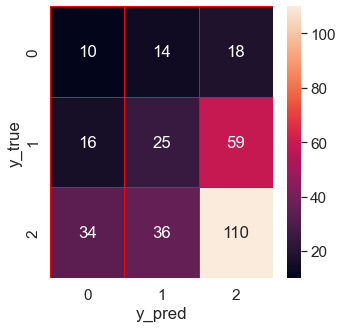

In [166]:
dt = DecisionTreeClassifier(random_state=1,max_depth=5)
dt.fit(train_x_b, train_y_b)
predictions = predict(dt, train_x_under, train_y_under, test_x_b)
cf, fscore, accuracy = evaluate(test_y_b, predictions)
fscore_tree_b_under=fscore
acc_tree_b_under=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

AdaBoost

In [163]:
level_encoder = LabelEncoder()
test_y_new_n = level_encoder.fit_transform(test_y_n)
train_y_new_n_under = level_encoder.fit_transform(train_y_under_n)


F1-score: 0.32701537669690534
Accuracy: 0.37267080745341613


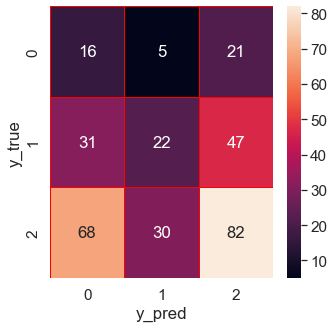

In [169]:
clf = AdaBoostClassifier(n_estimators=150, random_state=3)
dt.fit(train_x_under_n, train_y_under_n)
predictions = predict(dt, train_x_under_n, train_y_under_n, test_x_n)
cf, fscore, accuracy = evaluate(test_y_n, predictions)
fscore_ada_n_under=fscore
acc_ada_n_under=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

Feature selection

In [178]:
clfRFE =AdaBoostClassifier( n_estimators=150, random_state=3)
rfe = RFE(clfRFE, n_features_to_select = 15)
fit = rfe.fit(train_x_n, train_y_new_n)
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)

Num Features: 15
Selected Features: [False  True False  True False False False  True False False  True False
 False False False False  True  True  True  True False False  True  True
 False  True False  True False  True False False  True  True False False
 False False]
Feature Ranking: [13  1 24  1 20 22  5  1  2 16  1 19 15 11 23 21  1  1  1  1  8  7  1  1
  3  1 17  1 18  1 12  4  1  1 14  6  9 10]


In [179]:
result = np.where(fit.ranking_ == 1)
result

(array([ 1,  3,  7, 10, 16, 17, 18, 19, 22, 23, 25, 27, 29, 32, 33],
       dtype=int64),)

In [180]:
train_x_RFE =train_x_n.iloc[:,[ 1,  3,  7, 10, 16, 17, 18, 19, 22, 23, 25, 27, 29, 32, 33]]
test_x_RFE=test_x_n.iloc[:,[ 1,  3,  7, 10, 16, 17, 18, 19, 22, 23, 25, 27, 29, 32, 33]]

F1-score: 0.33103343465045587
Accuracy: 0.4720496894409938


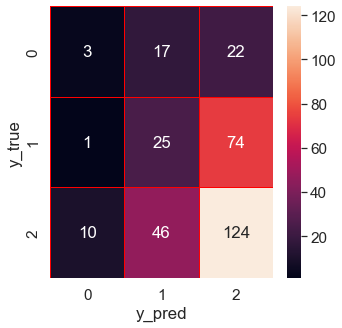

In [181]:
clf = AdaBoostClassifier(n_estimators=150, random_state=3)
dt.fit(train_x_RFE, train_y_n)
predictions = predict(dt, train_x_RFE, train_y_n, test_x_RFE)
cf, fscore, accuracy = evaluate(test_y_n, predictions)
fscore_ada_n_imp=fscore
acc_ada_n_imp=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

In [182]:
clfRFE =AdaBoostClassifier( n_estimators=150, random_state=3)
rfe = RFE(clfRFE, n_features_to_select = 25)
fit = rfe.fit(train_x_n, train_y_new_n)
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)

Num Features: 25
Selected Features: [False  True False  True False False  True  True  True False  True False
 False  True False False  True  True  True  True  True  True  True  True
  True  True False  True False  True False  True  True  True False  True
  True  True]
Feature Ranking: [ 3  1 14  1 10 12  1  1  1  6  1  9  5  1 13 11  1  1  1  1  1  1  1  1
  1  1  7  1  8  1  2  1  1  1  4  1  1  1]


In [184]:
result = np.where(fit.ranking_ == 1)
result

(array([ 1,  3,  6,  7,  8, 10, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
        27, 29, 31, 32, 33, 35, 36, 37], dtype=int64),)

In [185]:
train_x_RFE_2 =train_x_n.iloc[:,[1,  3,  6,  7,  8, 10, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
        27, 29, 31, 32, 33, 35, 36, 37]]
test_x_RFE_2=test_x_n.iloc[:,[ 1,  3,  6,  7,  8, 10, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
        27, 29, 31, 32, 33, 35, 36, 37]]

F1-score: 0.3303567210016537
Accuracy: 0.4472049689440994


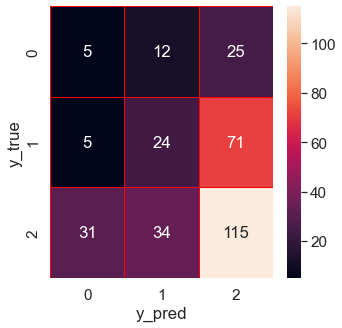

In [186]:
clf = AdaBoostClassifier(n_estimators=150, random_state=3)
dt.fit(train_x_RFE_2, train_y_n)
predictions = predict(dt, train_x_RFE_2, train_y_n, test_x_RFE_2)
cf, fscore, accuracy = evaluate(test_y_n, predictions)
fscore_ada_n_imp2=fscore
acc_ada_n_imp2=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

In [188]:
dtRFE = DecisionTreeClassifier(random_state=1,max_depth=5)
rfe = RFE(dtRFE, n_features_to_select = 15)
fit = rfe.fit(train_x_b, train_y_new_b)
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)

Num Features: 15
Selected Features: [ True  True False  True False  True  True False  True False  True False
 False False False False False False  True  True  True  True False False
 False False False False False False False False False  True False  True
 False  True  True False False]
Feature Ranking: [ 1  1  9  1  7  1  1  6  1 17  1 22 23 18 24 25  3 10  1  1  1  1 13 11
  2 14  4 21  5 15 19 16 20  1 12  1  8  1  1 26 27]


In [189]:
result = np.where(fit.ranking_ == 1)
result

(array([ 0,  1,  3,  5,  6,  8, 10, 18, 19, 20, 21, 33, 35, 37, 38],
       dtype=int64),)

In [191]:
train_x_RFE3 =train_x_b.iloc[:,[0,  1,  3,  5,  6,  8, 10, 18, 19, 20, 21, 33, 35, 37, 38]]
test_x_RFE3=test_x_b.iloc[:,[ 0,  1,  3,  5,  6,  8, 10, 18, 19, 20, 21, 33, 35, 37, 38]]

F1-score: 0.3160675883256528
Accuracy: 0.5062111801242236


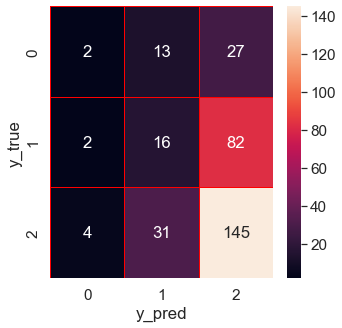

In [192]:
dtRFE.fit(train_x_RFE3, train_y_b)
predictions = predict(dtRFE, train_x_RFE3, train_y_b, test_x_RFE3)
cf, fscore, accuracy = evaluate(test_y_b, predictions)
fscore_tree_b_imp=fscore
acc_tree_b_imp=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()


In [193]:
dtRFE = DecisionTreeClassifier(random_state=1,max_depth=5)
rfe = RFE(dtRFE, n_features_to_select = 25)
fit = rfe.fit(train_x_b, train_y_new_b)
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)

Num Features: 25
Selected Features: [ True  True  True  True  True  True  True  True  True False  True False
 False False False False  True  True  True  True  True  True False  True
  True False  True False  True False False False False  True False  True
  True  True  True False False]
Feature Ranking: [ 1  1  1  1  1  1  1  1  1  7  1 12 13  8 14 15  1  1  1  1  1  1  3  1
  1  4  1 11  1  5  9  6 10  1  2  1  1  1  1 16 17]


In [194]:
result = np.where(fit.ranking_ == 1)
result

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 16, 17, 18, 19, 20, 21, 23,
        24, 26, 28, 33, 35, 36, 37, 38], dtype=int64),)

In [195]:
train_x_RFE4 =train_x_b.iloc[:,[0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 16, 17, 18, 19, 20, 21, 23,
        24, 26, 28, 33, 35, 36, 37, 38]]
test_x_RFE4=test_x_b.iloc[:,[ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 16, 17, 18, 19, 20, 21, 23,
        24, 26, 28, 33, 35, 36, 37, 38]]

F1-score: 0.3158858291565519
Accuracy: 0.5062111801242236


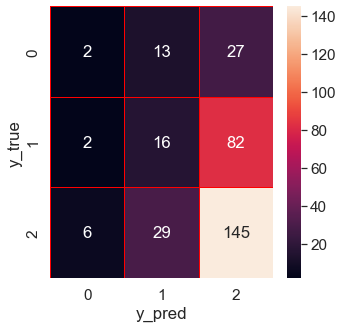

In [197]:
dtRFE.fit(train_x_RFE4, train_y_b)
predictions = predict(dtRFE, train_x_RFE4, train_y_b, test_x_RFE4)
cf, fscore, accuracy = evaluate(test_y_b, predictions)
fscore_tree_b_imp2=fscore
acc_tree_b_imp2=accuracy
print(f"F1-score: {fscore}")
print(f"Accuracy: {accuracy}")
f, ax=plt.subplots(figsize=(5,5))
sns.heatmap(cf,annot=True,linewidths=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

# 5. Best model for classification

In [200]:
data_c= {'Metric':  ['Accuracy','Fscore'],
          'Decision Tree': [acc_tree_b,fscore_tree_b],
        }
comparison_c = pd.DataFrame (data_c, columns = ['Metric','Decision Tree'])
comparison_c

,Metric,Decision Tree
0,Accuracy,0.506211
1,Fscore,0.315886


# Regression